# Reducing NIRCam Coronagraphy Data: A Hands-On Tutorial with spaceKLIP
---

In this notebook, you will learn how to reduce NIRCam coronagraphy data from the JWST ERS program on Direct Observations of Exoplanetary Systems ([Program 1386](https://www.stsci.edu/jwst/science-execution/program-information?id=1386)), with a focus on the exoplanet HIP 65426 b. The tutorial guides you step-by-step through the data reduction process using the spaceKLIP pipeline, offering a clear and concise workflow tailored for effective high-contrast imaging analysis. By the end of this notebook, you will have gained hands-on experience with the tools and techniques necessary for reducing NIRCam coronagraphic data, preparing you to apply these methods to other similar datasets.

<div class="alert alert-warning">
<b>Relation to other tutorials:</b> This notebook is intentionally very similar to the MIRI data reduction notebook.  Subsequent analyses steps will be carried out in the NIRCam post-pipeline analyses notebook. 
</div>

<div class="alert alert-info">
<b>NIRCam-specific information:</b> Steps and information specific to NIRCam are called out in blue.</div>


<h1 style="font-size: 24px; font-weight: 550;">Table of Contents</h1>

* [1. Introduction](#Introduction)
* [2. Setup and Imports](#Setup-and-Imports)
* [3. Download the Data](#Precursor:-Download-the-Data)
* [4. Level 1 Reductions](#Level-1-Reductions)
    * [4.1 Index Files into Database for Level 1](#Index-Files-into-Database-for-Level-1)
    * [4.2 Run Level 1 Pipeline](#Run-Level-1-Pipeline)
    * [4.3 Display Level 1 Reductions](#Display-Level-1-Reductions)
* [5. Level 2 Reductions](#Level-2-Reductions)
    * [5.1 Re-read Level 1 Outputs into Database](#Optional:-Re-read-Level-1-Outputs-into-Database)
    * [5.2 Run Level 2 Pipeline](#Run-Level-2-Pipeline)
    * [5.3 Display Level 2 Reductions](#Display-Level-2-Reductions)
* [6. Level 3 reductions: Preparations for PSF subtraction](#Level-3-reductions:-Preparations-for-PSF-subtraction)
    * [6.1 Re-read Level 2 Outputs into Database](#Optional:-Re-read-Level-2-Outputs-into-Database)
    * [6.2 Median-subtract Each Frame](#Median-subtract-Each-Frame)
    * [6.3 Find and Repair Bad Pixels](#Find-and-Repair-Bad-Pixels)
    * [6.4 Finish Pixel Cleanup](#Finish-Pixel-Cleanup)
    * [6.5 Improve PSF Centering and Alignment](#Improve-PSF-Centering-and-Alignment)
        * [6.5.1 Update NIRCam PSF Center Metadata](#Update-NIRCam-PSF-Center-Metadata)
        * [6.5.2 Re-center the Frames](#Re-center-the-Frames)
        * [6.5.2 Align Frames](#Align-Frames)
        * [6.5.3 Pad Empty Space Around Frames](#Pad-Empty-Space-Around-Frames)
        * [6.5.4 Display the Cleaned Datasets](#Display-the-Cleaned-Datasets)
* [7. Level 3 Reductions: KLIP](#Level-3-Reductions:-KLIP)
    * [7.1 PSF Subtraction: Option Using pyKLIP](#PSF-Subtraction:-Option-Using-pyKLIP)
    * [7.2 Re-read Level 3 Outputs into Database](#Optional:-Re-read-Level-3-Outputs-into-Database)


 





---

## Introduction

Directly imaging a planet or circumstellar disk around another star is a challenging task that requires specialized techniques and systems to suppress the star's bright light while preserving the faint light from the planet or disk which otherwise would be obscured by the glare of the star. This is achieved using starlight suppression optical systems, such as a starshade occulter or coronagraph, active wavefront control, advanced image processing techniques like differential imaging, and post-processing algorithms that effectively remove residual starlight (also referred to as speckles) using point spread function (PSF) subtraction methods. These advanced astronomical technologies and techniques enable High-Contrast Imaging (HCI), making it possible to study and characterize planetary systems in unprecedented detail.

A coronagraph instrument is a fundamental technology used for HCI as it is designed to block the light of an on-axis source, such as a star's light, using an internal or external occulter while letting the light of off-axis sources, like planets, to continue to pass through the optical system to the detector. The most common type of coronagraph is a Lyot-coronagraph which the Near Infrared Camera (NIRCam) on the James Webb Space Telescope (JWST) exemplifies, featuring five [Lyot-type coronagraphs](https://jwst-docs.stsci.edu/methods-and-roadmaps/jwst-high-contrast-imaging/jwst-high-contrast-imaging-supporting-technical-information/hci-optics#HCIOptics-LyCLyot-typecoronagraph:~:text=in%20the%20documentation.-,Lyot%2Dtype%20coronagraph,-See%20also%3A%C2%A0) that facilitate HCI at wavelengths of 2–5 µm with sub-arcsecond [inner working angles (IWA)](https://jwst-docs.stsci.edu/methods-and-roadmaps/jwst-high-contrast-imaging/jwst-high-contrast-imaging-supporting-technical-information/hci-inner-working-angle#gsc.tab=0:~:text=Inner%20Working%20Angle-,HCI%20Inner%20Working%20Angle,-The%20JWST%20inner) that allow for imaging of objects very close to their host. However, coronagraphs have certain limitations.

While coronagraphs block most of the star's light, there is some star leakage (or diffracted starlight) that propagates to the detector and results in a residual starlight "speckle" pattern or static wavefront errors that require additional post-processing and imaging techniques to remove. Also, the coronagraph design places constraints on the field of view (i.e. IWA), bandpass limitations, etc.

To address the limitations of coronagraphy, differential imaging techniques are used to separate starlight from the faint signals of celestial companions by exploiting differences in target, wavelength, or angular position. We use the following later in the notebook:

* **Angular Differential Imaging (ADI)**: This technique relies on the rotation of the telescope to capture a series of images at different field orientations. By aligning and combining these images, ADI can effectively differentiate the relatively static starlight from the rotating signal of the faint companion, enhancing contrast and detectability.
* **Reference Differential Imaging (RDI)**: This technique uses reference images of similar stars taken under similar observing conditions to subtract starlight from the target star's images. 
* **Spectral Differential Imaging (SDI)**: This technique takes advantage of the wavelength-dependent differences in the light from a star and its companion. Comparing images taken at different wavelengths helps suppress starlight while preserving the signal from the companion.

Post-processing such as Karhunen-Loeve Image Processing (KLIP) is used to perform PSF Subtraction and can enhance differential imaging techniques like ADI, RDI, and SDI. KLIP uses Principal Component Analysis (PCA) to create/reconstruct a model of the residual starlight PSF that is tailored to the observed data. Subtracting this model from the images helps remove the leftover residual light while preserving the light from faint sources. The [spaceKLIP data reduction pipeline](https://spaceklip.readthedocs.io/en/latest/) simplifies and streamlines the reduction and application of KLIP on JWST high-contrast imaging data.

**ADDITIONAL RESOURCES**

* [HCI Overview](https://iopscience.iop.org/article/10.1088/1538-3873/aceb31#:~:text=HCI%20is%20a%20catchall%20term,the%20vicinity%20of%20bright%20stars.): A comprehensive introduction to High-Contrast Imaging.
* [PCA Example](https://towardsdatascience.com/eigenfaces-recovering-humans-from-ghosts-17606c328184): A clear example to visualize Principal Component Analysis.


---


## Setup and Imports

<div class="alert alert-warning">

<b>Warning:</b> Currently, there is a bug when installing the `webbpsf_ext` dependency that prevents the file `wext_style.mplstyle` from being installed correctly via `pip`. This may cause some functions in `spaceKLIP` to crash. As a quick solution to this temporary issue, please follow the instructions listed [here](https://github.com/JarronL/webbpsf_ext/issues/14#issuecomment-2289698301).

</div>


In [43]:
import os
import pdb
import sys
import glob

import numpy as np
import astropy.io.fits as fits

import matplotlib.pyplot as plt
import matplotlib
matplotlib.rcParams.update({'font.size': 14})
%matplotlib inline

import spaceKLIP
from tutorial_plot_functions import display_image_comparisons

Note that currently the import of `webbpsf_ext` has a side effect of configuring extra verbose logging. We're not interested in that logging text, so let's quiet it. 



In [2]:
import webbpsf_ext
webbpsf_ext.setup_logging('WARN', verbose=False)

---

## Precursor: Download the Data

If you already have a copy of this data, you can adjust the paths below accordingly. For this notebook, we assume you don't have the data yet, so let's download it here.

We can do this using the [`jwst_mast_query`](https://github.com/spacetelescope/jwst_mast_query) package. Consult the package's documentation for more details.

We'll download all the uncalibrated raw data (`uncal.fits`), as we will use spaceKLIP to invoke the JWST pipeline with customized options and extra steps optimized for coronagraphy.

In [4]:
# Name the root directory where we will keep the data for this tutorial.
data_root = 'data_nircam_hd65426'

In [5]:
# Make subdirectories to put the data in.

os.makedirs(data_root, exist_ok = True)
os.makedirs(os.path.join(data_root, 'uncal'), exist_ok = True)
  
# Invoke the download.
download_cmd = "yes | jwst_download.py --propID 1386 -i nircam -l 700 --obsnums 1 2 3 "+\
               "--outsubdir data_nircam_hd65426/uncal --skip_propID2outsubdir -f uncal --date_select 59789.0+"
import subprocess
subprocess.Popen(download_cmd, shell=True).wait()

INSTRUMENT:  nircam
obsmode:  [None]
propID:  01386
obsnums:  [1, 2, 3]
INFO: MAST API token accepted, welcome Kayli Glidic [astroquery.mast.auth]
MJD range: 59789.0 60530.93054232464
No obsmode given. Querying for all files for nircam.
allowed filetype list: ['_uncal.fits']
select obsnum [1, 2, 3]: keeping 64 from 101

######################
### Selected Products:
######################
 proposal_id obsnum    obsID  parent_obsid                             obs_id   sca visit dataproduct_type                               productFilename    filetype  calib_level     size                                   description
        1386      1 87767907      91707772 jw01386001001_03106_00008_nrcalong along   001            image jw01386001001_03106_00008_nrcalong_uncal.fits _uncal.fits            1  4155840 exposure (L1b): Uncalibrated 4D exposure data
        1386      1 87767908      91707772 jw01386001001_03106_00009_nrcalong along   001            image jw01386001001_03106_00009_nrcalong_u

0

---

## Level 1 Reductions

### Index Files into Database for Level 1
SpaceKLIP relies on a `Database` class to track observations, data files, and the relationships between them. 

We begin by creating a database, and reading files into it. 

For purposes of this tutorial, let's only reduce one filter's worth of data. 

In [6]:
filt = 'F444W'  # Set this to None to disable filter selection when loading data in, and load all filters.

In [7]:
# Initialize spaceKLIP database.
database = spaceKLIP.database.create_database(input_dir = os.path.join(data_root, 'uncal'),
                                              output_dir=data_root, 
                                              filt=filt,
                                              pid=1386)

[spaceKLIP.database:INFO] --> Identified 1 concatenation(s)
[spaceKLIP.database:INFO]   --> Concatenation 1: JWST_NIRCAM_NRCALONG_F444W_MASKRND_MASK335R_SUB320A335R
TYPE  EXP_TYPE DATAMODL TELESCOP ... BUNIT      ROLL_REF      BLURFWHM
---- --------- -------- -------- ... ----- ------------------ --------
 SCI NRC_CORON   STAGE0     JWST ...    DN 110.30193021092403      nan
 SCI NRC_CORON   STAGE0     JWST ...    DN 120.38229928192678      nan
 REF NRC_CORON   STAGE0     JWST ...    DN 110.03164126509459      nan
 REF NRC_CORON   STAGE0     JWST ...    DN 110.03167095674748      nan
 REF NRC_CORON   STAGE0     JWST ...    DN 110.03169329690344      nan
 REF NRC_CORON   STAGE0     JWST ...    DN 110.03168369757408      nan
 REF NRC_CORON   STAGE0     JWST ...    DN 110.03167513958529      nan
 REF NRC_CORON   STAGE0     JWST ...    DN 110.03166494524143      nan
 REF NRC_CORON   STAGE0     JWST ...    DN 110.03164410512026      nan
 REF NRC_CORON   STAGE0     JWST ...    DN 110.0316709

The above is a bit verbose and can be hard for a human to parse; let's ask the database to summarize what it contains: 

In [8]:
database.summarize()

NIRCAM_F444W_MASK335R
	STAGE0: 11 files;	2 SCI, 9 REF


** Add some description of the files we're looking at, what the difference between SCI and REF is, what the difference between the two SCI files is. 

---

### Run Level 1 Pipeline


The `Coron1Pipeline` ([calwebb_coron1](https://spaceklip.readthedocs.io/en/latest/stage1.html)) in spaceKLIP is a custom subclass of the JWST Level 1 pipeline, `Detector1Pipeline` ([calwebb_detector1](https://jwst-pipeline.readthedocs.io/en/latest/jwst/pipeline/calwebb_detector1.html#calwebb-detector1)). It is specifically designed to optimize the processing of high-contrast imaging data typical of coronagraphic observations. This pipeline applies group-by-group detector-level corrections, followed by ramp fitting, to the raw, uncalibrated data ([`uncal.fits`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/pipeline/calwebb_detector1.html#:~:text=g.%20%E2%80%9Cjw80600012001_02101_00003_mirimage_ramp.fits%E2%80%9D.-,Inputs,-%EF%83%81)). The out is calibrated count rate products ([`rateints.fits`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/pipeline/calwebb_detector1.html#:~:text=be%20ImageModel.-,3D%20countrate%20product,%EF%83%81,-Data%20model)).

The `Coron1Pipeline` performs the following steps for NIRCam, with custom spaceKLIP steps and parameters highlighted/boldfaced:

> * [`group_scale`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/group_scale/description.html)
> * [`dq_init`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/dq_init/description.html)
> * [`saturation`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/saturation/description.html):
>   * **`flag_rcsat`**: Flag high dark current RC pixels as saturated? (Default: False).
>   * **`grow_diagonal`**: Flag diagonal neighboring pixels (or only bottom/top/left/right)? (Default: True).
>   * [`n_pix_grow_sat`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/saturation/arguments.html)
> * [`ipc`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/ipc/description.html)
> * [`superbias`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/superbias/description.html)
> * [`refpix`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/refpix/index.html)
>    * [`odd_even_columns`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/refpix/arguments.html#:~:text=%2D%2D-,odd_even_columns,-If%20the%20odd_even_columns)
>    * **`nlower`**, **`nupper`**, **`nleft`**, **`nright`**</span>: Number of pixels around edges to use as pseudo-refpix in NIRCam subarrays (Default: 4).
>    * **`nrow_off`**, **`ncol_off`**: Offset the reference pixel region from the top/bottom and left/right edges of the frame (Default: 0).
> * [`linearity`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/linearity/description.html) 
> *  [`dark_current`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/dark_current/description.html) 
> * [`persistence`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/persistence/description.html)
> * [`jump detection`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/jump/description.html)
>   * [`rejection_threshold`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/jump/arguments.html#:~:text=%2D%2D-,rejection_threshold,-%3A%20A%20floating%2Dpoint), [`three_group_rejection_threshold`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/jump/arguments.html#:~:text=three_group_rejection_threshold), [`four_group_rejection_threshold`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/jump/arguments.html#:~:text=four_group_rejection_threshold), [`maximum_cores`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/jump/arguments.html#:~:text=%2D%2D-,maximum_cores,-%3A%20The%20number%20of)
> * **`subtract_1overf`**: Removes 1/f noise from the data.
>    * **`model_type`**: Type of model to fit for 1/f noise removal ('median', 'mean', Defualt: 'savgol')
>    * **`sat_frac`**: Maximum saturation fraction for fitting slopes (Default: 0.5)
>    * **`combine_ints`**: Combine all integrations before ramp fitting? (Default: True)
>    * **`vertical_corr`**: Apply a vertical correction to remove vertical striping (Default: True)
>    * **`nproc`**: Number of processes to use for parallel processing (Default: 4)
> * [`ramp_fit`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/ramp_fitting/description.html)
>      * **`save_calibrated_ramp`**: Save the calibrated ramp? The default is False.
> * [`gain_scale`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/gain_scale/description.html). 


The following cell will run the `Coron1Pipeline` for all input data in the spaceKLIP database, saving the output to a subdirectory named `stage1`.

In [9]:
spaceKLIP.coron1pipeline.run_obs(database=database,
                       steps={'group_scale': {'skip': False},
                              'dq_init': {'skip': False},
                              'saturation': {'n_pix_grow_sat': 1,
                                             'grow_diagonal': False},
                              'refpix': {'odd_even_columns': True,
                                         'odd_even_rows': True,
                                         'nlower': 4,
                                         'nupper': 4,
                                         'nleft': 4,
                                         'nright': 4,
                                         'nrow_off': 0,
                                         'ncol_off': 0},
                              'dark_current': {'skip': True},
                              'persistence': {'skip': True},
                              'jump': {'rejection_threshold': 4.,
                                       'three_group_rejection_threshold': 4.,
                                       'four_group_rejection_threshold': 4.,
                                       'maximum_cores': 'all'},
                              'subtract_1overf': {'model_type': 'savgol',
                                                  'sat_frac': 0.5,
                                                  'combine_ints': True,
                                                  'vertical_corr': True,
                                                  'nproc': 4},
                              'ramp_fit': {'save_calibrated_ramp': False,
                                          'maximum_cores': 'all'}},
                       subdir='stage1')

[spaceKLIP.coron1pipeline:INFO] --> Concatenation JWST_NIRCAM_NRCALONG_F444W_MASKRND_MASK335R_SUB320A335R
[spaceKLIP.coron1pipeline:INFO]   --> Coron1Pipeline: processing jw01386002001_0310a_00001_nrcalong_uncal.fits


/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/stcal/jump/twopoint_difference.py:243: RuntimeWarning: All-NaN slice encountered
  median_diffs = np.nanmedian(first_diffs, axis=(0, 1))
/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/stcal/jump/twopoint_difference.py:243: RuntimeWarning: All-NaN slice encountered
  median_diffs = np.nanmedian(first_diffs, axis=(0, 1))
/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/stcal/jump/twopoint_difference.py:243: RuntimeWarning: All-NaN slice encountered
  median_diffs = np.nanmedian(first_diffs, axis=(0, 1))
/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/stcal/jump/twopoint_difference.py:243: RuntimeWarning: All-NaN slice encountered
  median_diffs = np.nanmedian(first_diffs, axis=(0, 1))
/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/stcal/jump/twopoint_difference.py:243: RuntimeWarning: All-NaN slice encountered
  median_diffs = np.nanmedian(first_diffs

[spaceKLIP.coron1pipeline:INFO]   --> Coron1Pipeline: processing jw01386003001_0310a_00001_nrcalong_uncal.fits


/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/stcal/jump/twopoint_difference.py:243: RuntimeWarning: All-NaN slice encountered
  median_diffs = np.nanmedian(first_diffs, axis=(0, 1))
/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/stcal/jump/twopoint_difference.py:243: RuntimeWarning: All-NaN slice encountered
  median_diffs = np.nanmedian(first_diffs, axis=(0, 1))
/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/stcal/jump/twopoint_difference.py:243: RuntimeWarning: All-NaN slice encountered
  median_diffs = np.nanmedian(first_diffs, axis=(0, 1))
/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/stcal/jump/twopoint_difference.py:243: RuntimeWarning: All-NaN slice encountered
  median_diffs = np.nanmedian(first_diffs, axis=(0, 1))
/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/stcal/jump/twopoint_difference.py:243: RuntimeWarning: All-NaN slice encountered
  median_diffs = np.nanmedian(first_diffs

[spaceKLIP.coron1pipeline:INFO]   --> Coron1Pipeline: processing jw01386001001_0310e_00001_nrcalong_uncal.fits
[spaceKLIP.coron1pipeline:INFO]   --> Coron1Pipeline: processing jw01386001001_0310e_00002_nrcalong_uncal.fits
[spaceKLIP.coron1pipeline:INFO]   --> Coron1Pipeline: processing jw01386001001_0310e_00003_nrcalong_uncal.fits
[spaceKLIP.coron1pipeline:INFO]   --> Coron1Pipeline: processing jw01386001001_0310e_00004_nrcalong_uncal.fits
[spaceKLIP.coron1pipeline:INFO]   --> Coron1Pipeline: processing jw01386001001_0310e_00005_nrcalong_uncal.fits
[spaceKLIP.coron1pipeline:INFO]   --> Coron1Pipeline: processing jw01386001001_0310e_00006_nrcalong_uncal.fits
[spaceKLIP.coron1pipeline:INFO]   --> Coron1Pipeline: processing jw01386001001_0310e_00007_nrcalong_uncal.fits
[spaceKLIP.coron1pipeline:INFO]   --> Coron1Pipeline: processing jw01386001001_0310e_00008_nrcalong_uncal.fits
[spaceKLIP.coron1pipeline:INFO]   --> Coron1Pipeline: processing jw01386001001_0310e_00009_nrcalong_uncal.fits


We can now examine the updated database, which shows that all available files for each filter have been processed to Stage 1.

**Note**: The Stage 0 files are automatically removed from the database since there is no further processing required for them. However, the files remain on disk.


In [10]:
database.summarize()

NIRCAM_F444W_MASK335R
	STAGE1: 11 files;	2 SCI, 9 REF


---

### Display Level 1 Reductions

Let's examine the science and reference PSF data in the F444W filter that we just processed through the `Coron1Pipeline`. You can use the built-in plotting function `spaceKLIP.plotting.display_coron_dataset` to display the images by passing the database object to the function. Each image includes annotations, with pixels marked as `DO_NOT_USE` in the data quality (DQ) extension highlighted in orange. Additionally, the plotting function allows you to restrict the display to a specific filter and save the images. The images will be saved as a PDF file to the current working directory by default, or to a specified path if provided by the user passed to the `save_filename` keyword argument.



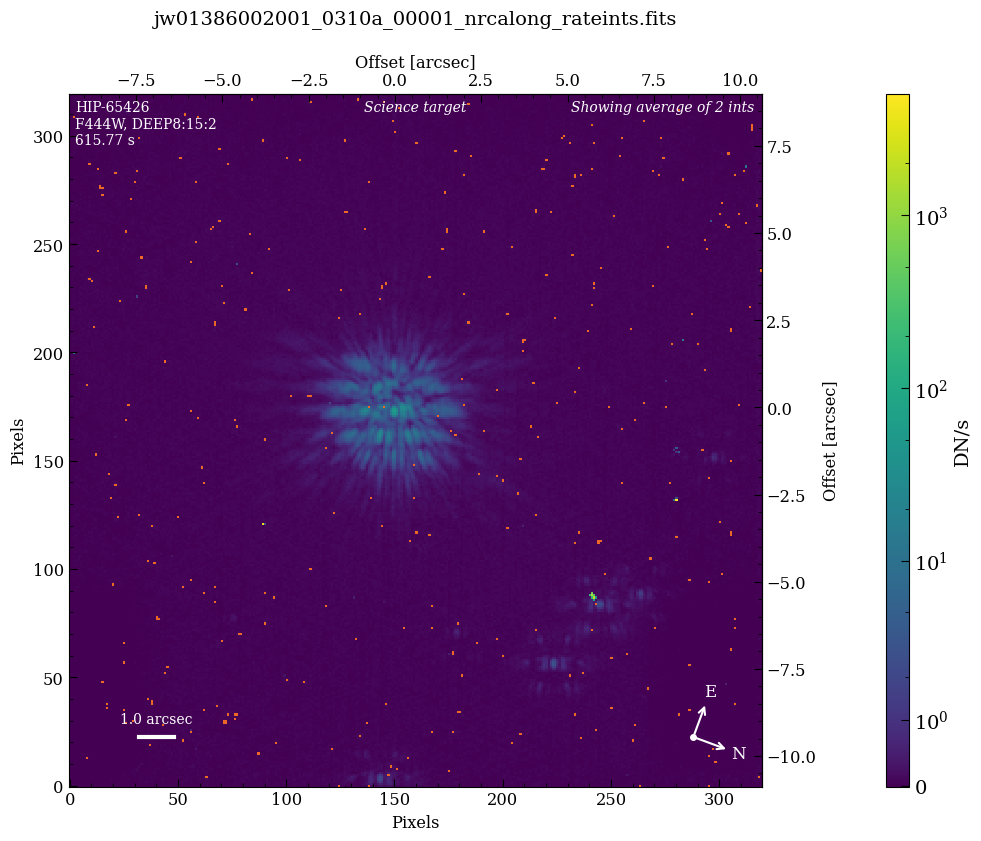

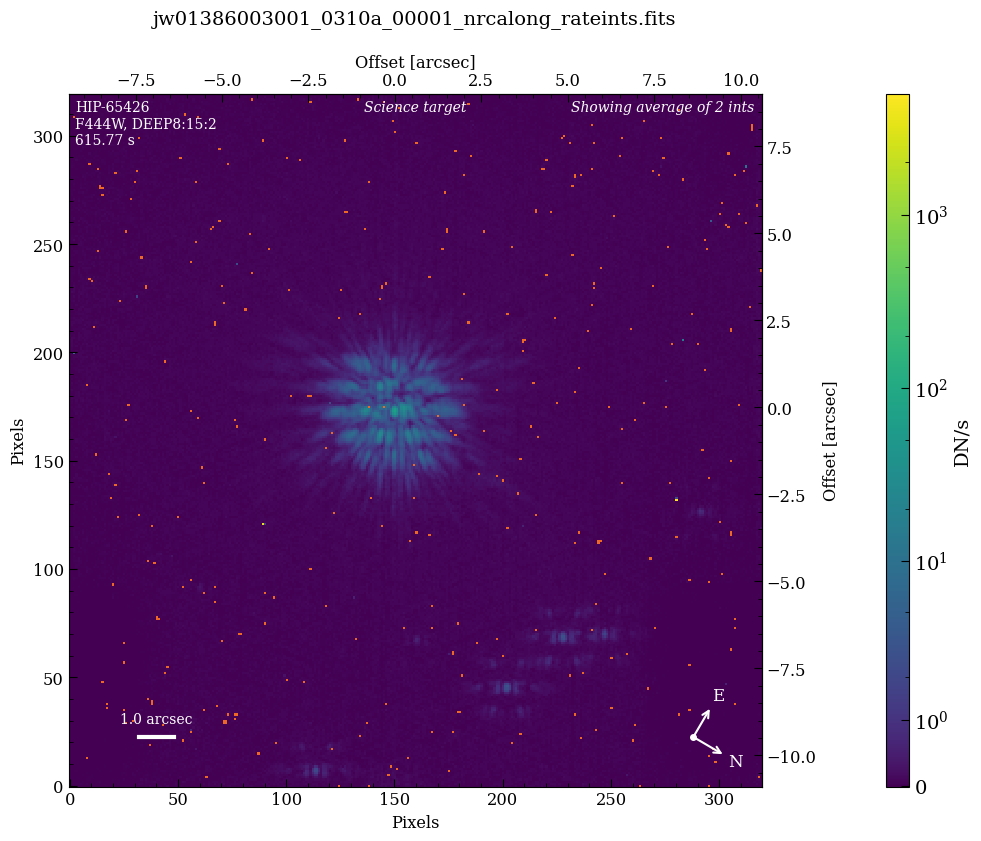

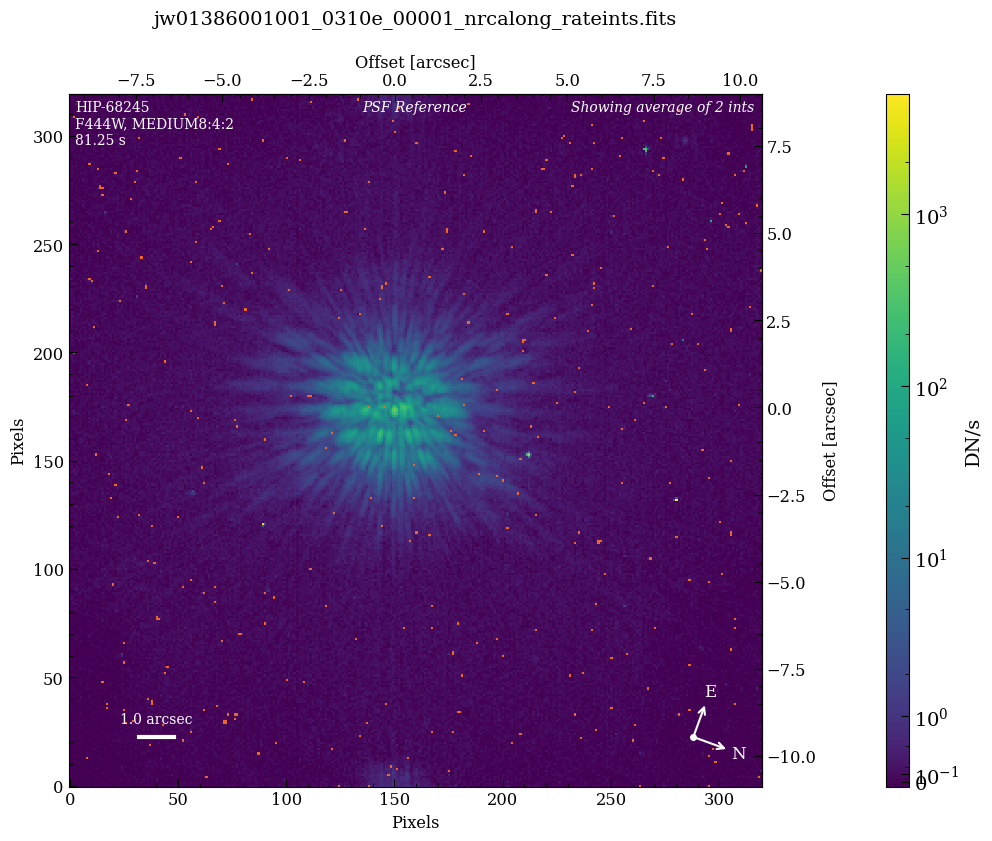

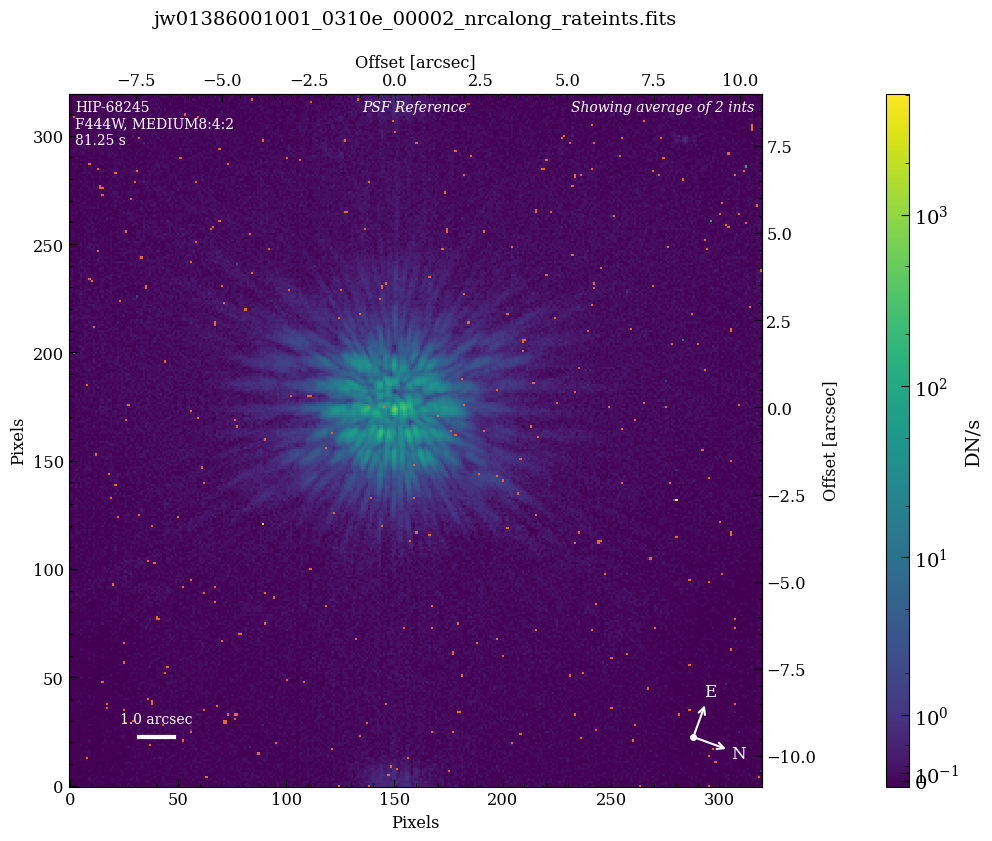

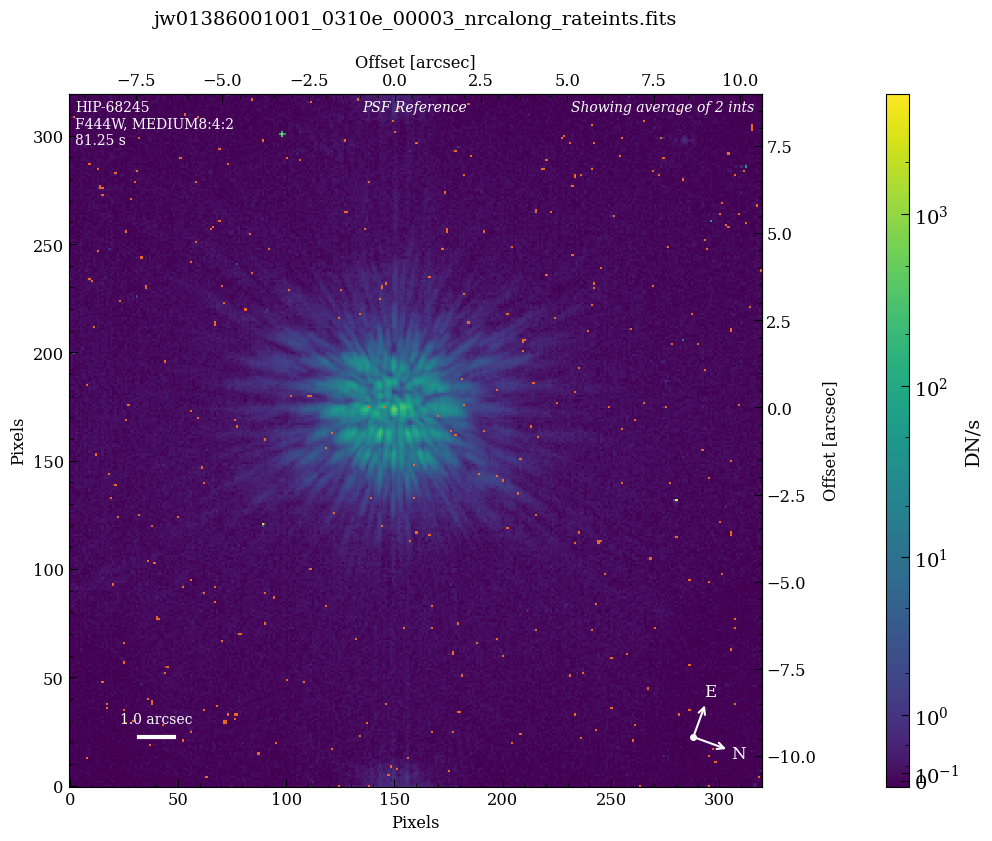

...

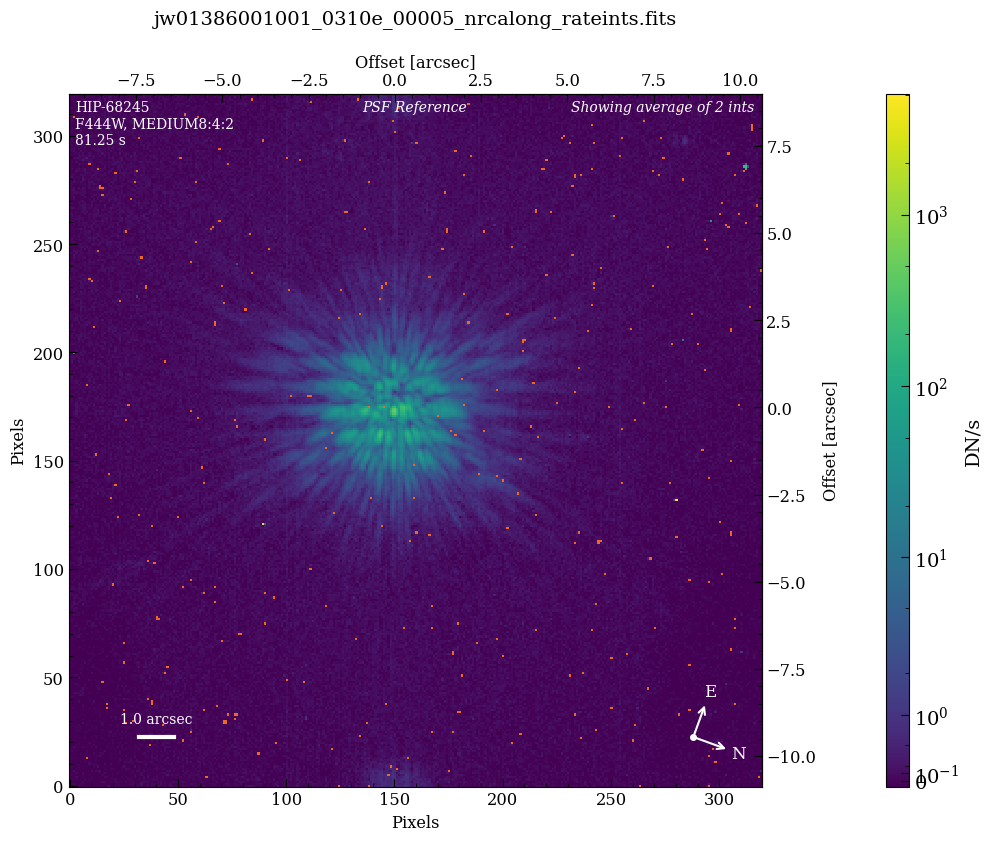

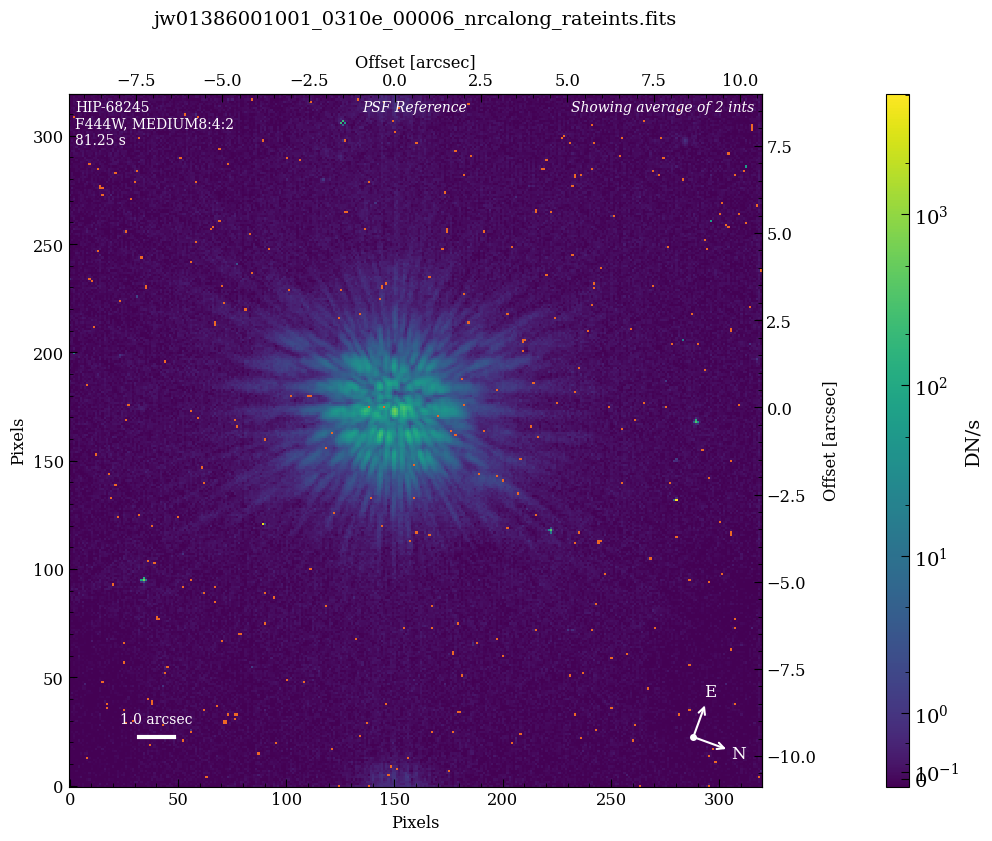

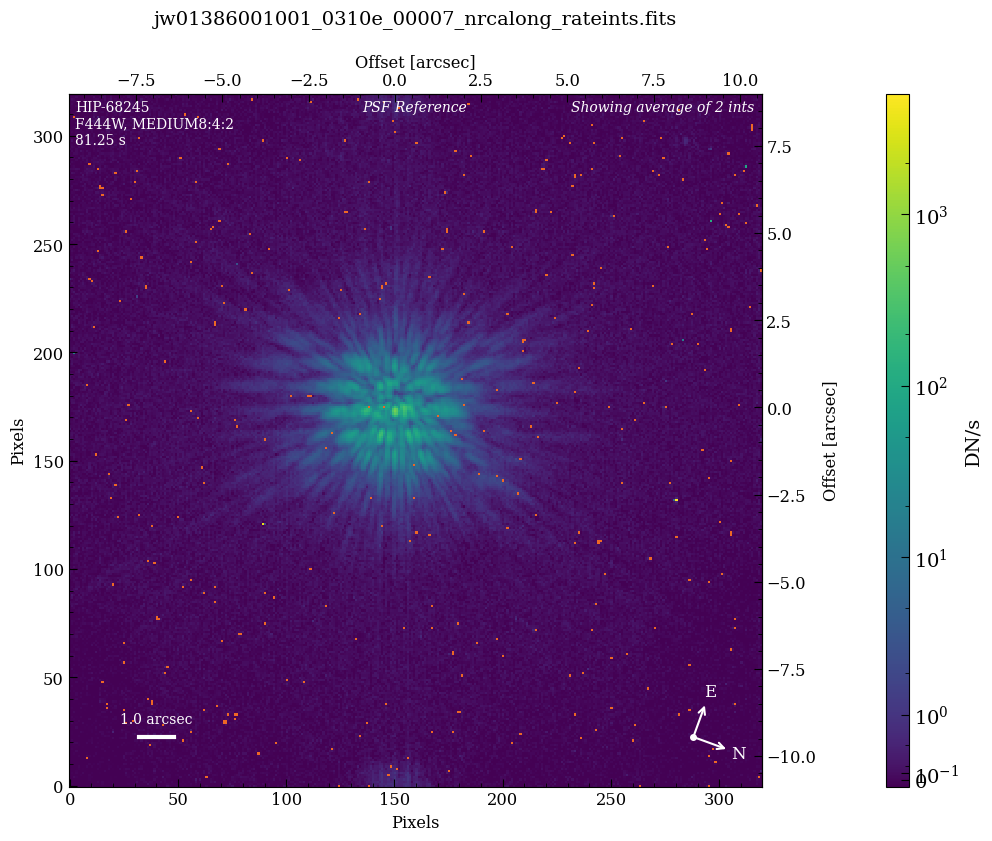

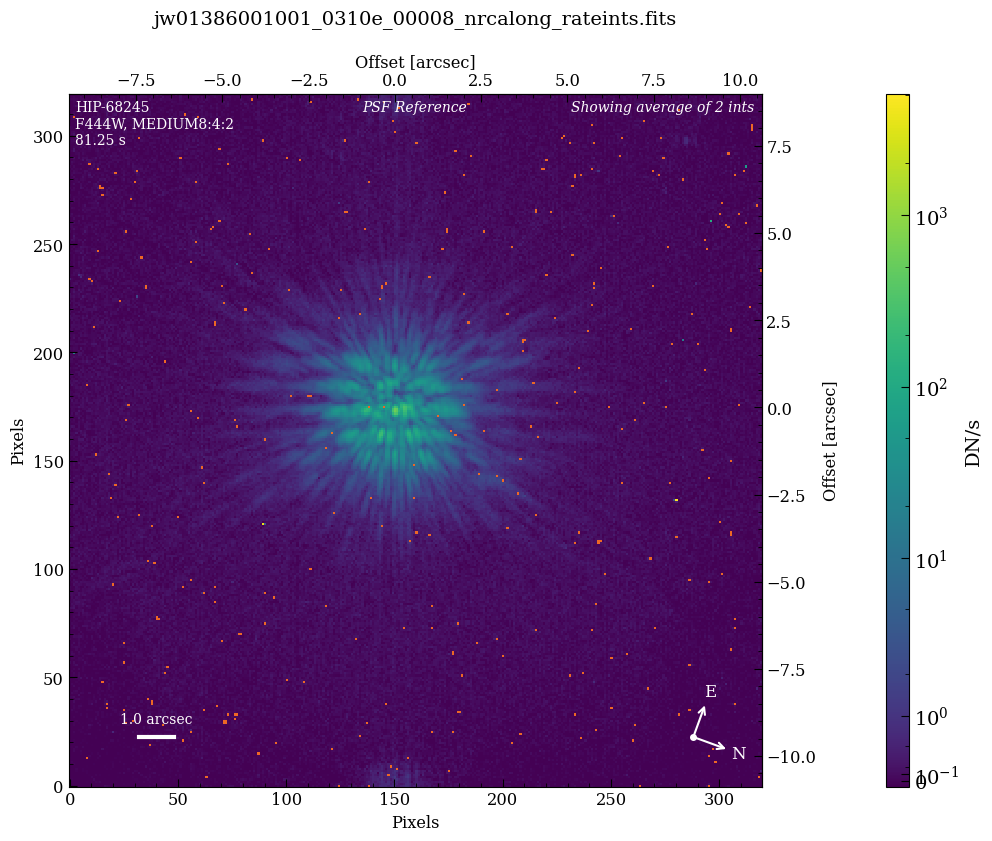

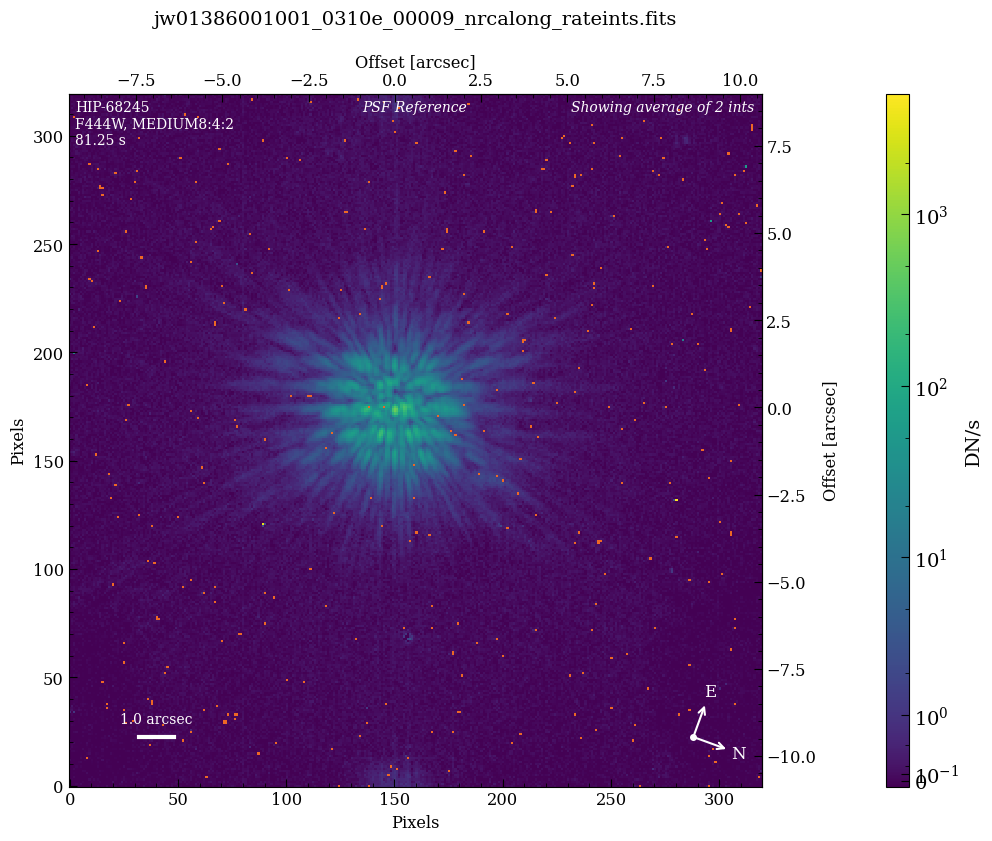

In [11]:
spaceKLIP.plotting.display_coron_dataset(database, 
                                         restrict_to=filt, save_filename='plots_f444w_stage1.pdf')

---

## Level 2 Reductions

### Optional: Re-read Level 1 Outputs into Database 
This shows how you can start re-reductions at this stage in the processing, once the previous steps have been completed. *** Add more context here, why would you want to re-read the data? For example, if you had been passed some files already run through Level 1

In [ ]:
database = spaceKLIP.database.create_database(input_dir = os.path.join(data_root, 'stage1'),
                                              file_type='rateints.fits',
                                              output_dir=data_root, 
                                              filt=filt,
                                              pid=1386)

---

### Run Level 2 Pipeline

The `Coron2Pipeline` ([`calwebb_coron2`](https://spaceklip.readthedocs.io/en/latest/stage2.html)) in spaceKLIP is a customized subclass of the JWST Level 2 Imaging Pipeline, `Image2Pipeline` ([`calwebb_image2`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/pipeline/calwebb_image2.html)), specifically designed to optimize the processing of high-contrast imaging data typical of coronagraphic observations. This stage requires little customization. This pipeline performs additional corrections and calibrations on the countrate products ([`rateints.fits`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/pipeline/calwebb_image2.html#:~:text=per%2Dintegration%20results)) from stage 1 to produce fully calibrated products ([`calints.fits`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/pipeline/calwebb_image2.html#:~:text=2D%20or%203D%20calibrated,%EF%83%81)). 

The `Coron2Pipeline` includes the following steps for NIRCam, with custom spaceKLIP steps and parameters highlighted/bolded:

> * [`background`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/background_step/index.html#background-step)
> * [`assign_wcs`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/assign_wcs/index.html#assign-wcs-step)
> * [`flat_field`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/flatfield/index.html#flatfield-step)
> * [`photom`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/photom/index.html#photom-step)
> * [`resample`](https://jwst-pipeline.readthedocs.io/en/latest/jwst/resample/index.html#resample-step)
> * [**`outlier_detection`**](https://jwst-pipeline.readthedocs.io/en/latest/jwst/outlier_detection/outlier_detection_coron.html)

The following cell will run the `Coron2Pipeline` for all input data in the spaceKLIP database, saving the output to a subdirectory named `stage2`.

In [13]:
spaceKLIP.coron2pipeline.run_obs(database=database,
                                steps={'outlier_detection': {'skip': False}},
                                )

[spaceKLIP.coron2pipeline:INFO] --> Concatenation JWST_NIRCAM_NRCALONG_F444W_MASKRND_MASK335R_SUB320A335R
[spaceKLIP.coron2pipeline:INFO]   --> Coron2Pipeline: processing jw01386002001_0310a_00001_nrcalong_rateints.fits
[spaceKLIP.coron2pipeline:INFO]   --> Coron2Pipeline: processing jw01386003001_0310a_00001_nrcalong_rateints.fits
[spaceKLIP.coron2pipeline:INFO]   --> Coron2Pipeline: processing jw01386001001_0310e_00001_nrcalong_rateints.fits
[spaceKLIP.coron2pipeline:INFO]   --> Coron2Pipeline: processing jw01386001001_0310e_00002_nrcalong_rateints.fits
[spaceKLIP.coron2pipeline:INFO]   --> Coron2Pipeline: processing jw01386001001_0310e_00003_nrcalong_rateints.fits
[spaceKLIP.coron2pipeline:INFO]   --> Coron2Pipeline: processing jw01386001001_0310e_00004_nrcalong_rateints.fits
[spaceKLIP.coron2pipeline:INFO]   --> Coron2Pipeline: processing jw01386001001_0310e_00005_nrcalong_rateints.fits
[spaceKLIP.coron2pipeline:INFO]   --> Coron2Pipeline: processing jw01386001001_0310e_00006_nrcal

And again, we can check that the database now contains Level 2 reduced versions of all the files:

In [14]:
database.summarize()

NIRCAM_F444W_MASK335R
	STAGE2: 11 files;	2 SCI, 9 REF


---

### Display Level 2 Reductions

These images look nearly identical to the Stage 1 outputs, but note that the display units have been rescaled from DN/s (countrate) to physical units of MJy/sr (surface brightness). You may also notice that more pixels have been flagged as `DO_NOT_USE` after applying the outlier detection step in Stage 2.


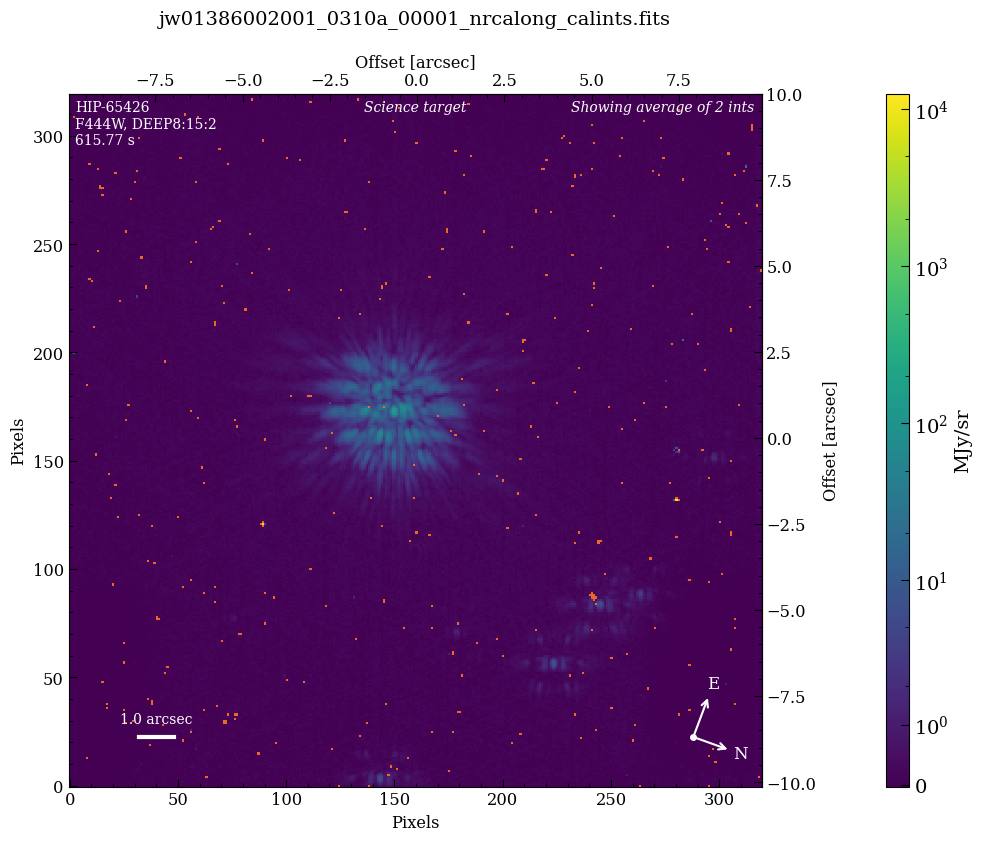

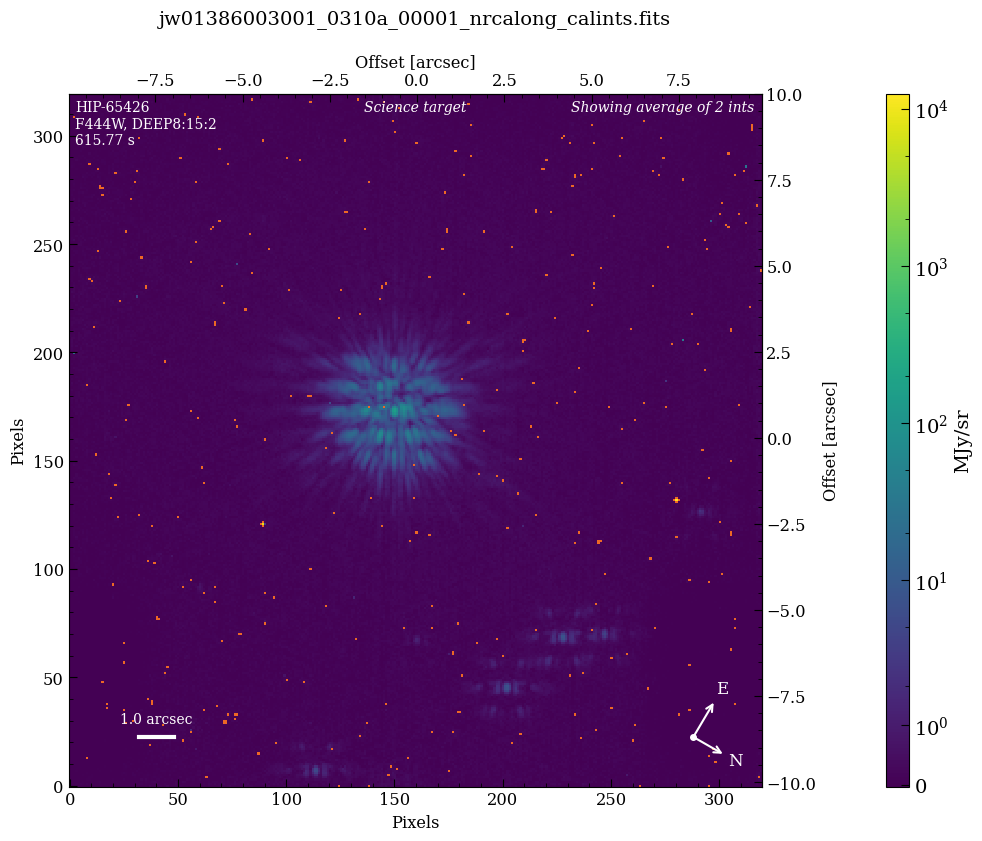

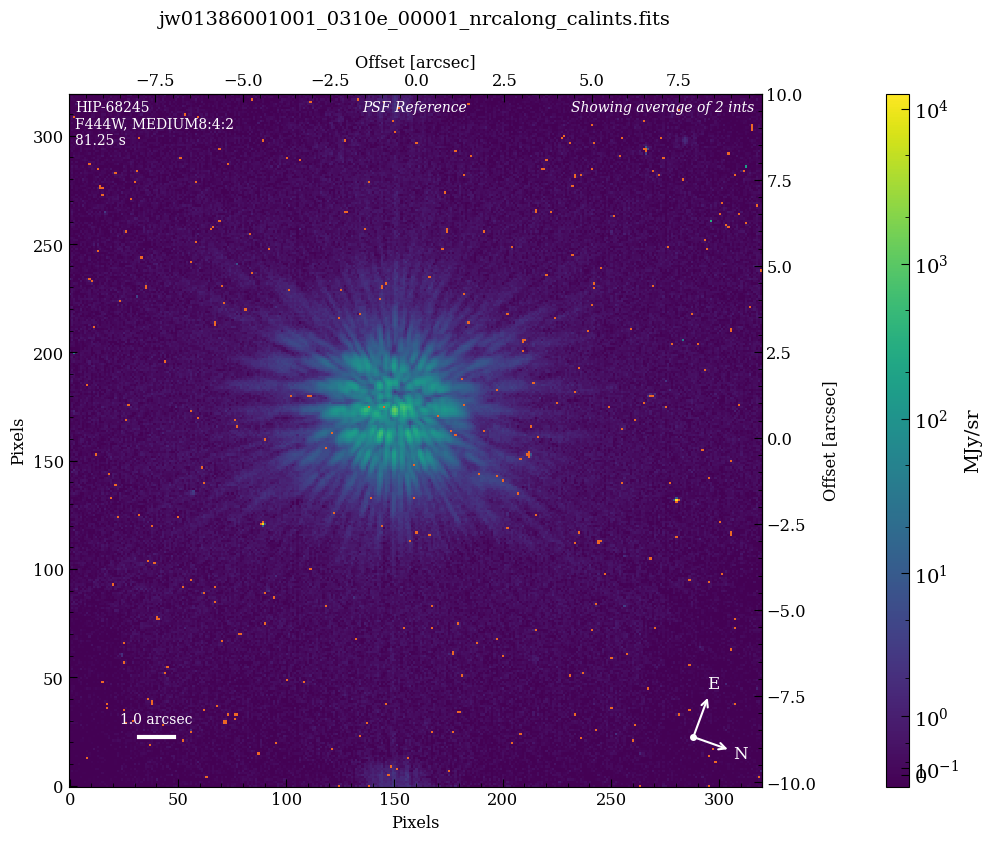

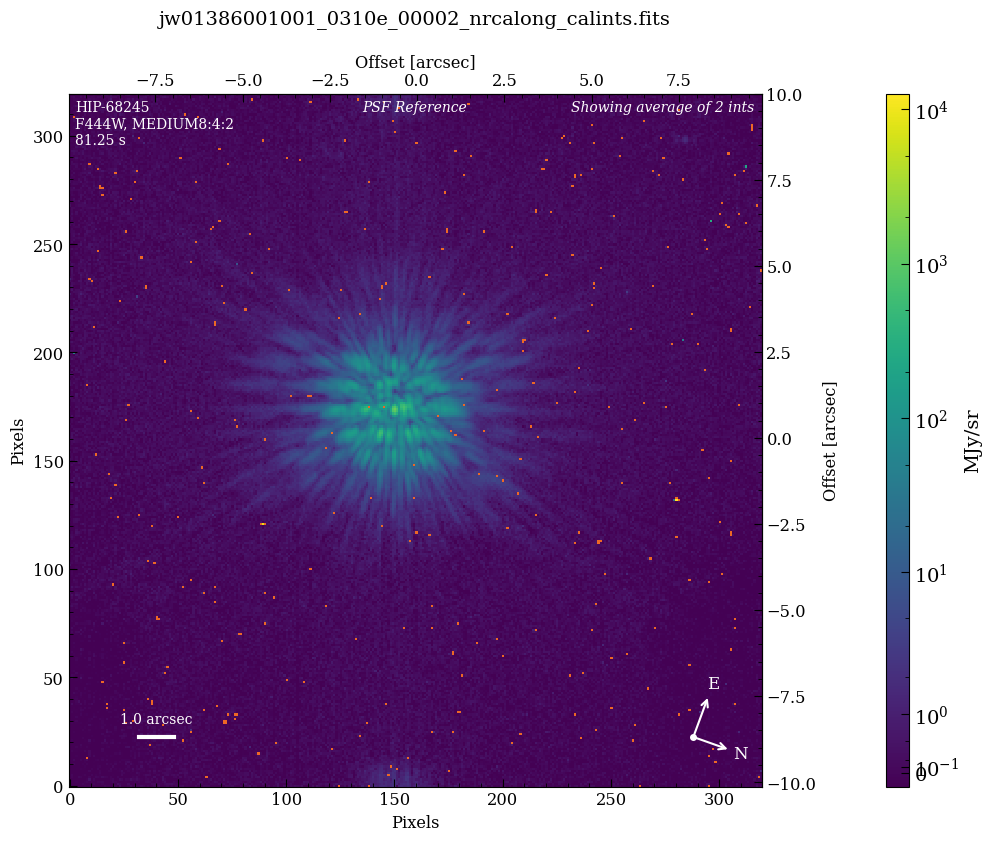

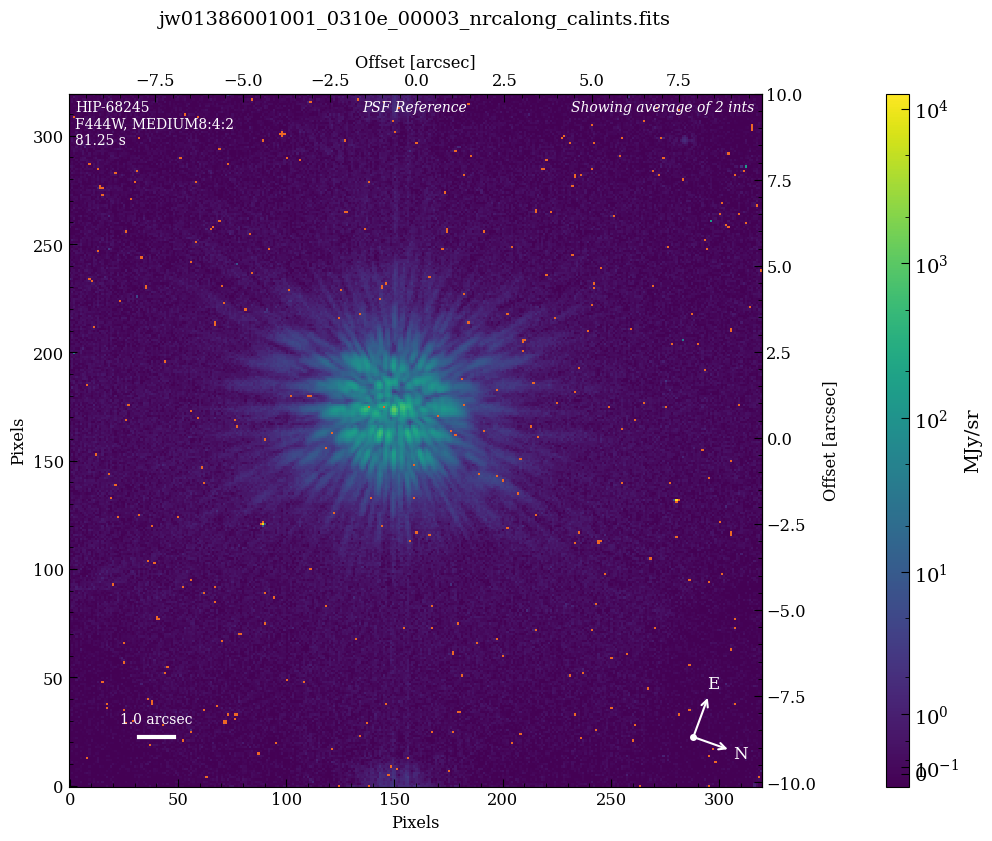

...

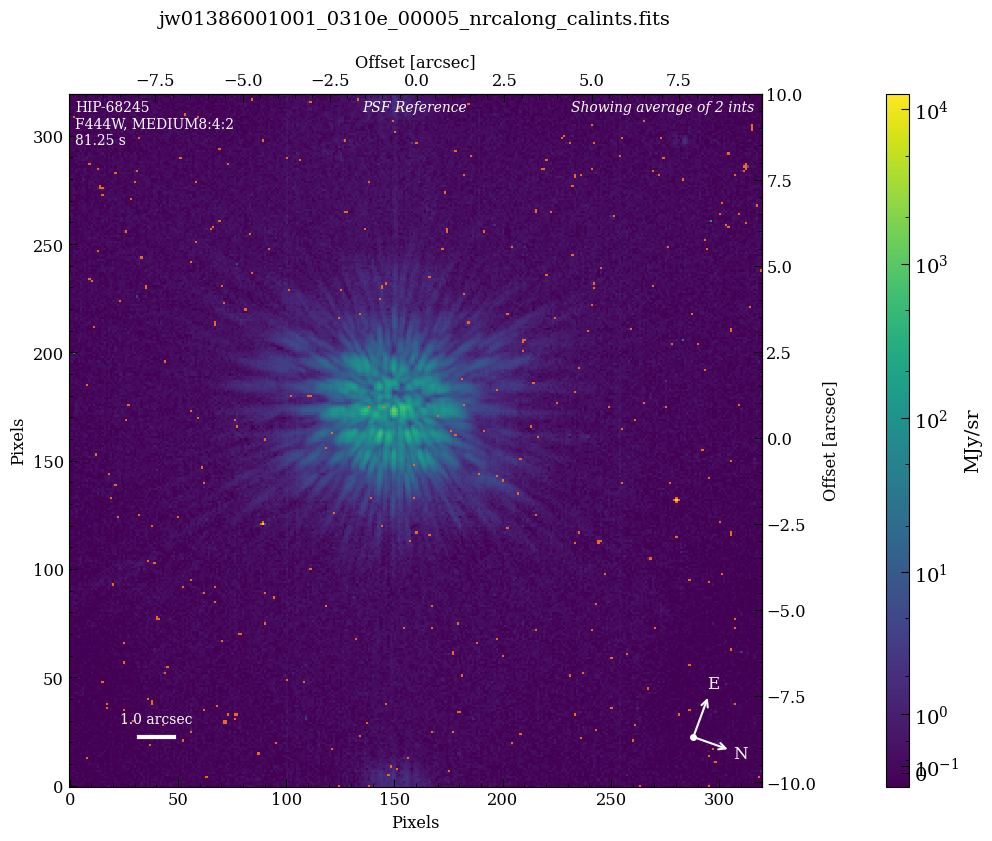

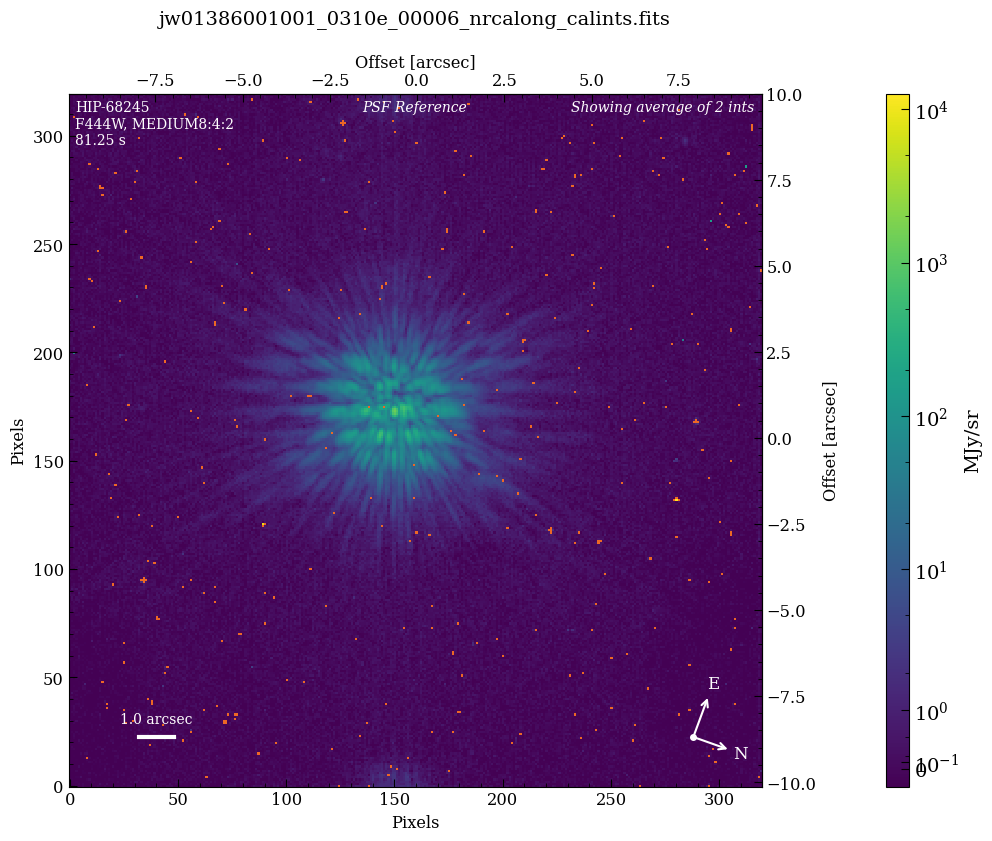

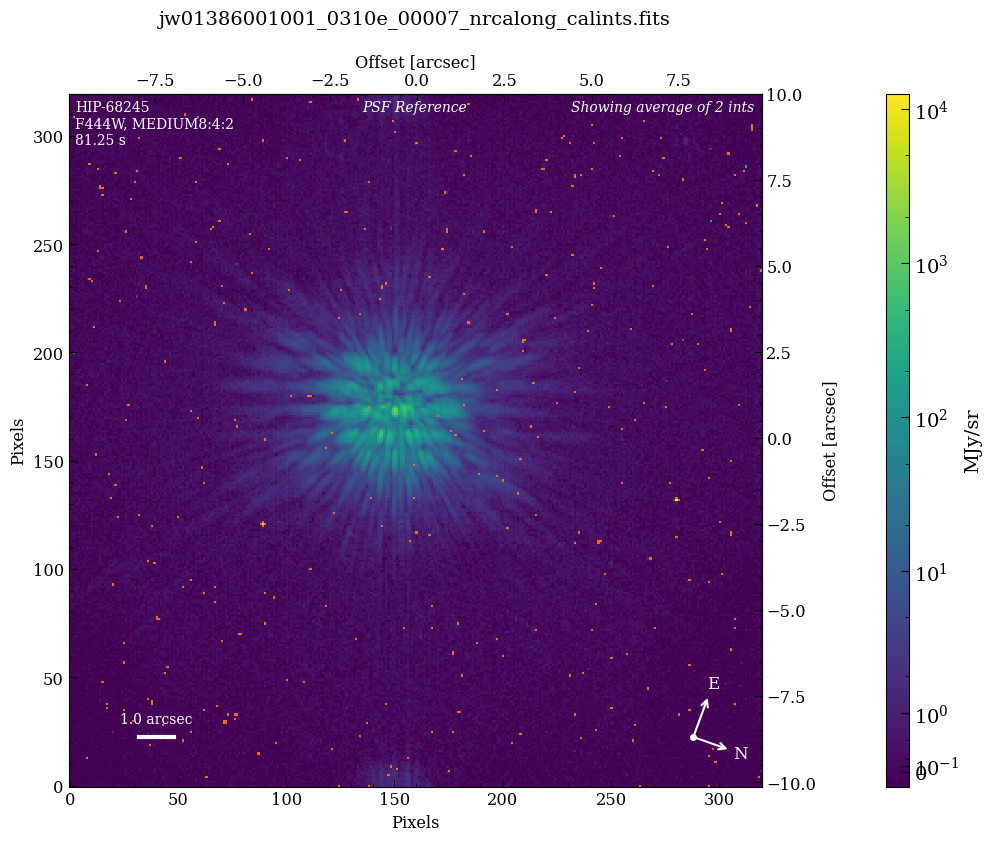

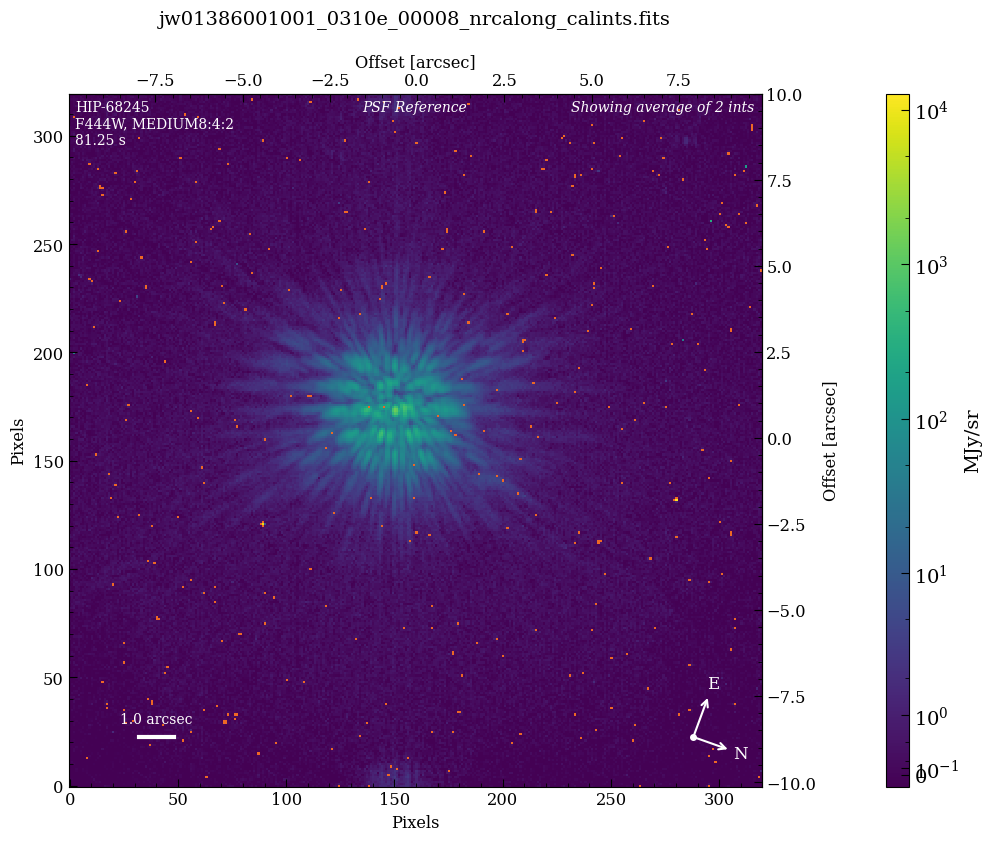

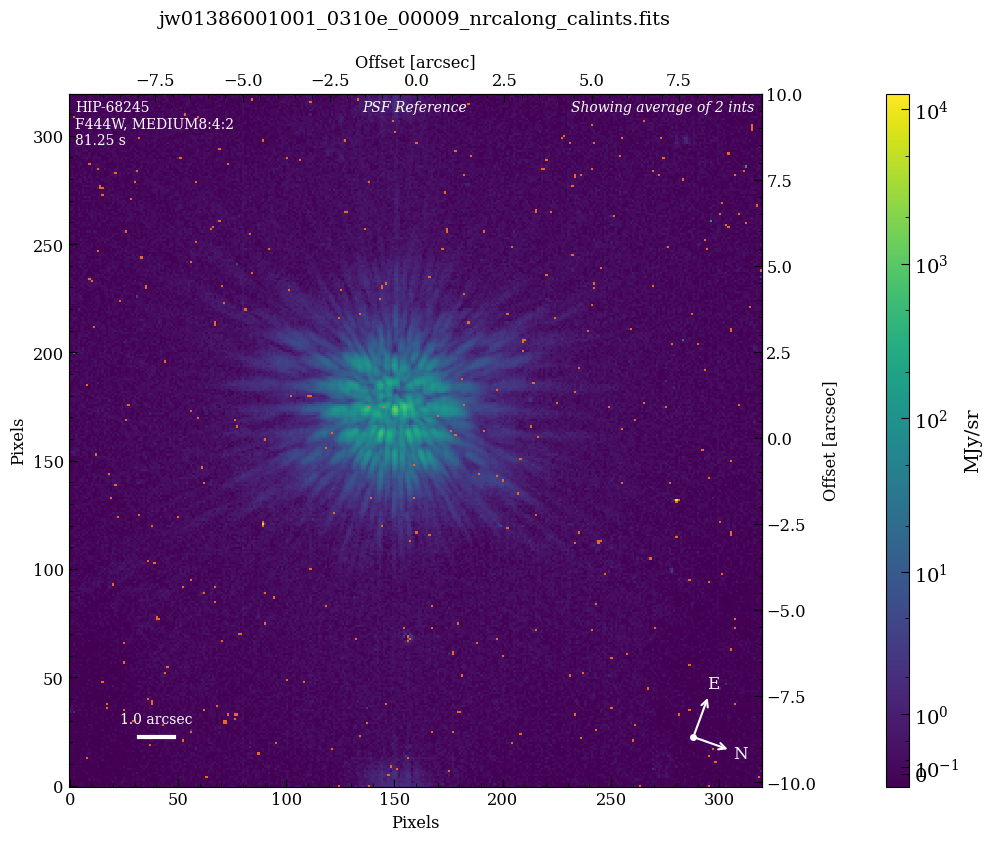

In [15]:
spaceKLIP.plotting.display_coron_dataset(database, 
                                         restrict_to='F444W', save_filename='plots_f444w_stage2.pdf')

---

## Level 3 reductions: Preparations for PSF subtraction

As is often the case in high-contrast imaging, obtaining good PSF subtractions depends sensitively on preparing the data ahead of time.

In the following section, we improve coronagraphic reductions, taking special care with image centering, background subtraction, and bad pixel replacement/interpolation, all before the PSF subtraction steps.

---

### Optional: Re-read Level 2 Outputs into Database
This shows how you can start re-reductions at this stage in the processing, once the previous steps have been completed.

In [16]:
database = spaceKLIP.database.create_database(input_dir = os.path.join(data_root, 'stage2'),
                                              file_type='calints.fits',
                                              output_dir=data_root, 
                                              filt=filt,
                                              pid=1386)

[spaceKLIP.database:INFO] --> Identified 1 concatenation(s)
[spaceKLIP.database:INFO]   --> Concatenation 1: JWST_NIRCAM_NRCALONG_F444W_MASKRND_MASK335R_SUB320A335R
TYPE  EXP_TYPE DATAMODL TELESCOP ... BUNIT       ROLL_REF      BLURFWHM
---- --------- -------- -------- ... ------ ------------------ --------
 SCI NRC_CORON   STAGE2     JWST ... MJy/sr 110.30193021092403      nan
 SCI NRC_CORON   STAGE2     JWST ... MJy/sr 120.38229928192678      nan
 REF NRC_CORON   STAGE2     JWST ... MJy/sr 110.03164126509459      nan
 REF NRC_CORON   STAGE2     JWST ... MJy/sr 110.03167095674748      nan
 REF NRC_CORON   STAGE2     JWST ... MJy/sr 110.03169329690344      nan
 REF NRC_CORON   STAGE2     JWST ... MJy/sr 110.03168369757408      nan
 REF NRC_CORON   STAGE2     JWST ... MJy/sr 110.03167513958529      nan
 REF NRC_CORON   STAGE2     JWST ... MJy/sr 110.03166494524143      nan
 REF NRC_CORON   STAGE2     JWST ... MJy/sr 110.03164410512026      nan
 REF NRC_CORON   STAGE2     JWST ... MJy/sr

---

This is where we will do some extra image processing to improve coronagraphic reductions. *** Explain what ImageTools is

In [17]:
# Initialize spaceKLIP image manipulation tools class.
imageTools = spaceKLIP.imagetools.ImageTools(database=database)

---

### Median-subtract Each Frame

Median subtraction is a recommended preprocessing step for NIRCam data, as it enhances the accuracy and reliability of PSF subtractions produced by algorithms like KLIP. The `subtract_median` function calculates the median image, which represents the median background level and any static artifacts across frames (integrations) within a data product. By subtracting this median image from each frame, the process reduces uncalibrated bias drifts and better isolates the signal from the source PSF, as demonstrated in the plot below.

Median subtraction gets applied to all files in the database after masking out bright sources using sigma clipping or similar techniques. The `subtract_median` method supports the following median subtraction methods:
> * `robust`: Computes the median after masking bright stars using Median Absolute Deviation (MAD).
> * `sigma_clipped`: Uses astropy.stats.sigma_clipped_stats to robustly calculate the median, clipping outliers based on a specified `sigma` value.
> * `border` (default): Computes the median using data only from the outer border of the image, excluding bright central sources.
> * `simple`: Performs a straightforward median calculation without additional masking or clipping.

<div class="alert alert-info">
    <b>NIRCam-specific information:</b> The <tt>subtract_median</tt> background subtraction step is only recommended for NIRCam, not MIRI.</div>


In [18]:
# Median-subtract each frame to mitigate uncalibrated bias drifts. 

imageTools.subtract_median(types=['SCI', 'SCI_TA', 'SCI_BG', 'REF', 'REF_TA', 'REF_BG'],
                           subdir='medsub')

[spaceKLIP.imagetools:INFO] Median subtraction using method=border
[spaceKLIP.imagetools:INFO] --> Concatenation JWST_NIRCAM_NRCALONG_F444W_MASKRND_MASK335R_SUB320A335R
[spaceKLIP.imagetools:INFO]   --> Median subtraction: jw01386002001_0310a_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Median subtraction: mean of frame median = 0.08
[spaceKLIP.imagetools:INFO]   --> Median subtraction: jw01386003001_0310a_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Median subtraction: mean of frame median = 0.09
[spaceKLIP.imagetools:INFO]   --> Median subtraction: jw01386001001_0310e_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Median subtraction: mean of frame median = 0.16
[spaceKLIP.imagetools:INFO]   --> Median subtraction: jw01386001001_0310e_00002_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Median subtraction: mean of frame median = 0.12
[spaceKLIP.imagetools:INFO]   --> Median subtraction: jw01386001001_0310e_00003_nrcalong_calint

To interactively browse through the files in the database, set `interact=True`. This will enable a slider for navigating through the images. If you prefer to generate and save static plots in a PDF, set `interact=False`. 







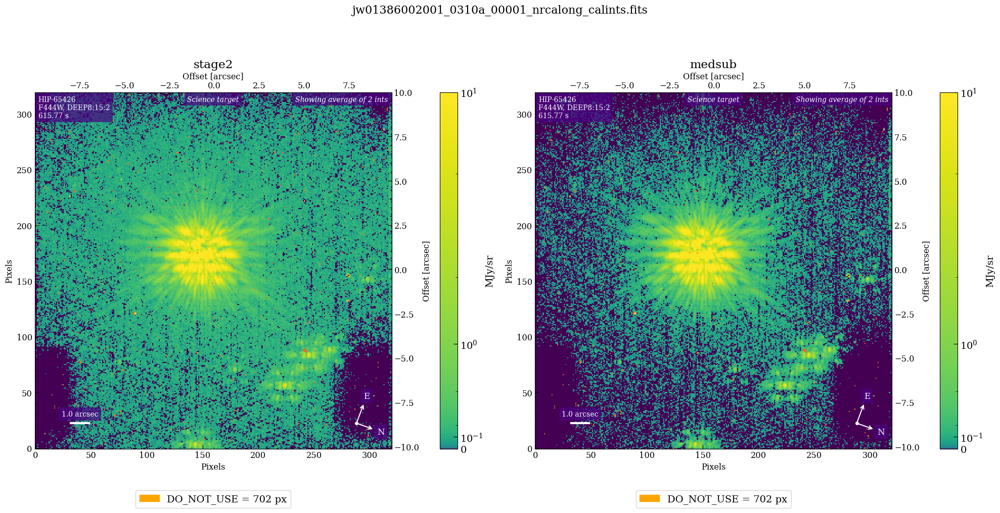

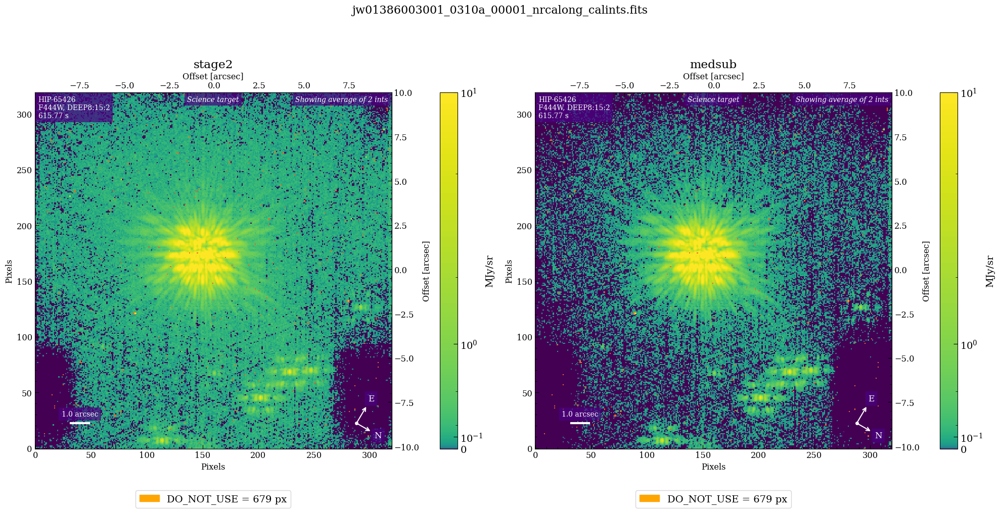

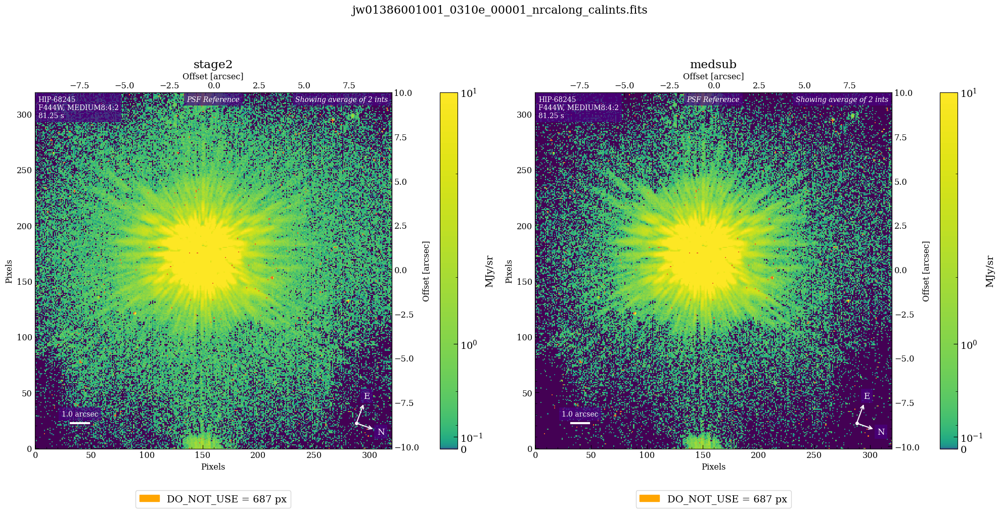

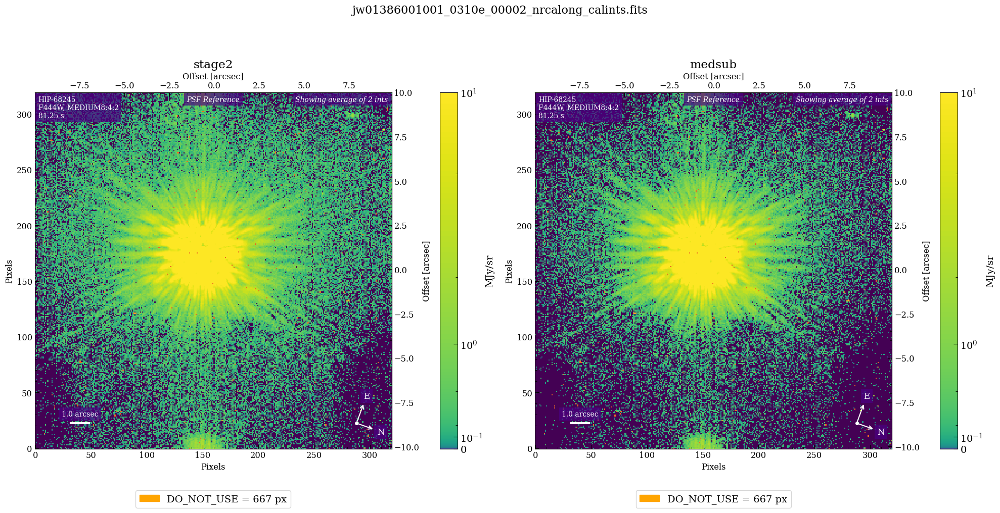

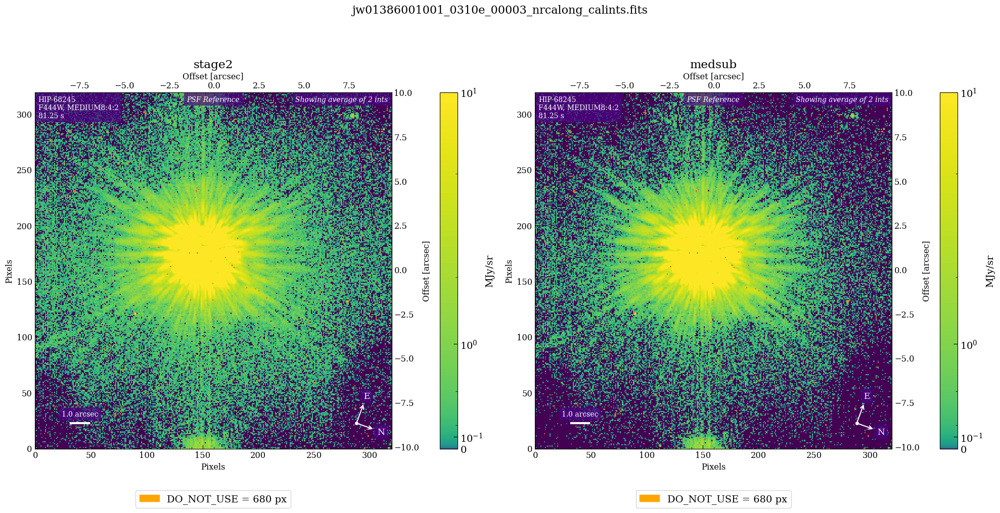

...

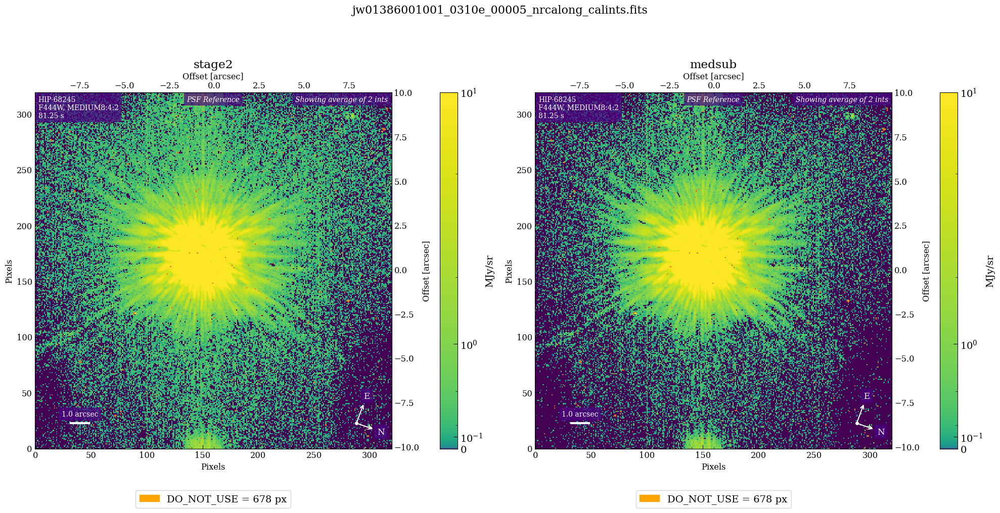

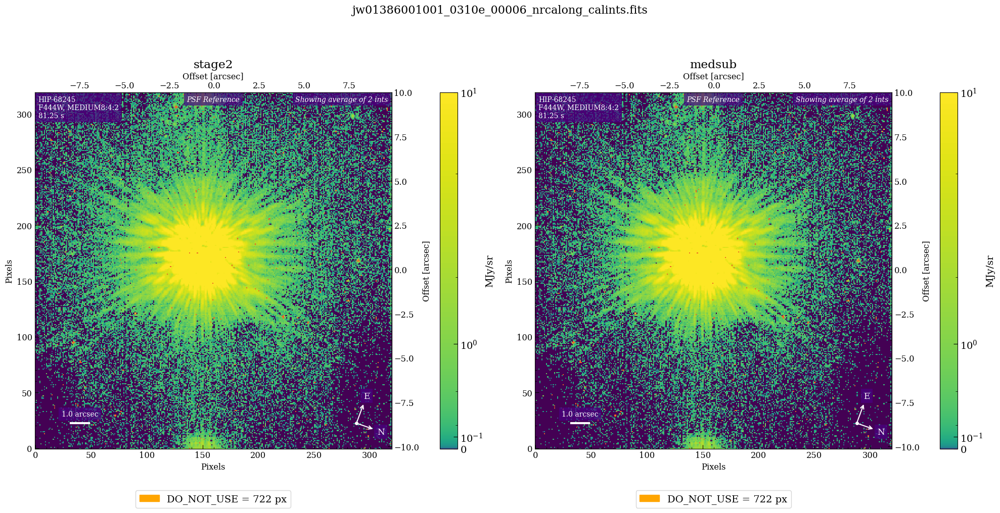

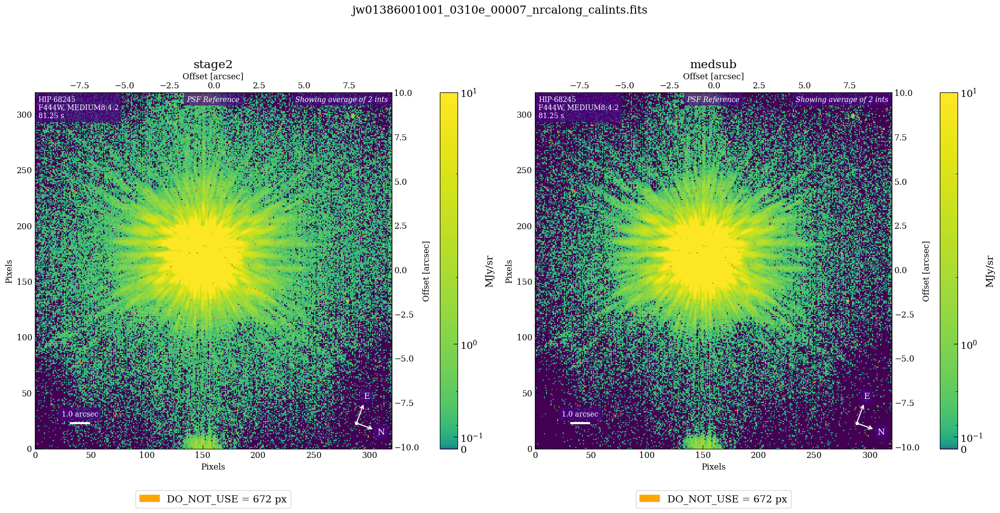

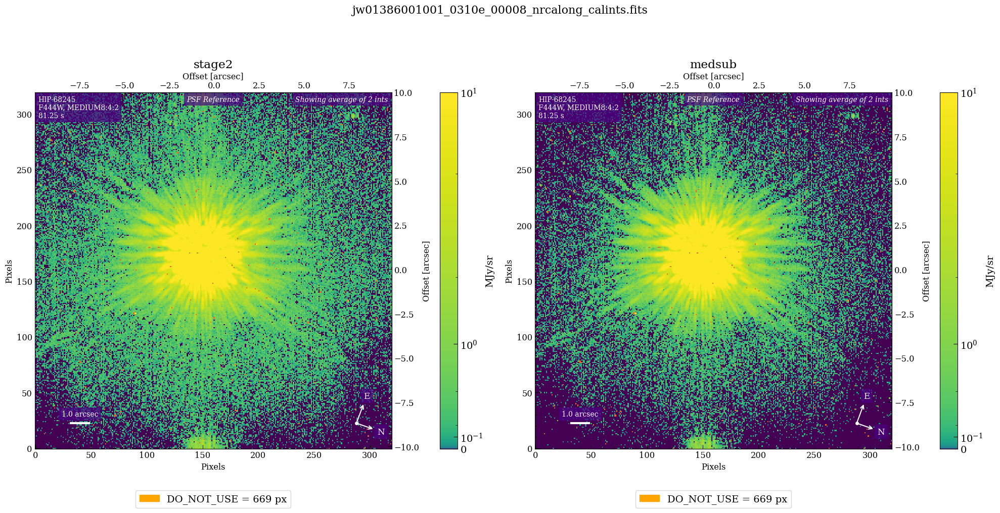

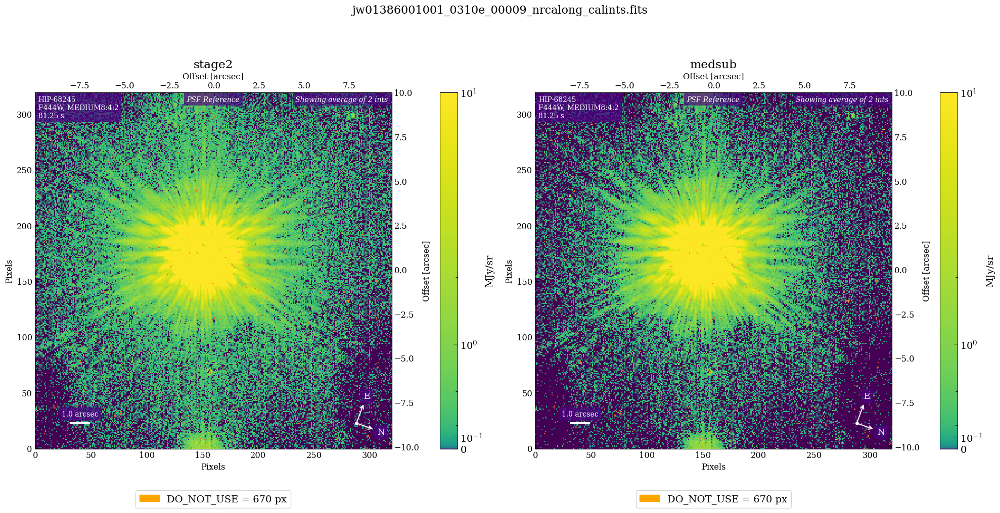

In [44]:
# Compare before and after median subtraction. 
display_image_comparisons(database, ['stage2', 'medsub'], 
                          restrict_to=None, interact=False,
                          save_filename='medsub_f444w_comparison.pdf', 
                          vmin=0, vmax=10, a=0.00001) # Optional: Set the vmin/vmax/stretch 


---

### Find and Repair Bad Pixels

For NIRCam, the JWST pipeline does not sufficiently repair bad pixels (i.e., anomalous outliers) within the coronagraphic subarrays.

Here, we use the custom functions within spaceKLIP to detect and repair these bad pixels.

<div class="alert alert-info">
    <b>NIRCam-specific information:</b> The <tt>fix_bad_pixels</tt> step were developed originally for NIRCam and are tuned to work pretty well on NIRCam data. </div>
    
1. The **`find_bad_pixels`** step identifies bad pixels in observational data using the following currently available methods:
>* `dqarr`: Identifies bad pixels based on the DQ array. This method flags pixels marked as `DO_NOT_USE` that are not `NONSCIENCE`. This is the default method.
>* `sigclip`: Uses sigma clipping to detect additional bad pixels by identifying those that significantly deviate from their neighbors based on a statistical threshold (`sigma`).
>    * The `shift_x` and `shift_y` parameters, such as [-1, 0, 1], define the range of pixel shifts (left/right and up/down) used in sigma clipping to compare a pixel with its neighbors and identify deviations.
>* `custom`: Employs a user-provided binary map with explicitly marked bad pixels, allowing for customized detections.

2. The **`clean_bad_pixels`** function refines previously identified bad pixels using a sequence of the currently available cleaning methods:
>* `timemed`: Replaces bad pixels with their median value from good frames.
>* `medfilt`: Applies a median filter across the image plane to replace bad pixels, with the filter size specified by size.

Different finding/cleaning methods should be combined in a single string with a '+' sign, without whitespace, to apply them sequentially.


---

<div class="alert alert-warning">
<b>WARNING:</b> The <tt>fix_bad_pixels</tt> function will soon be deprecated in spaceKLIP and replaced by the <tt>find_bad_pixels</tt> and <tt>clean_bad_pixels</tt> functions. The following cell uses the original approach for finding and cleaning bad pixels until the new methods are fully integrated.







In [20]:
# Fix bad pixels using custom spaceKLIP routines. Multiple routines can be
# combined in a custom order by joining them with a + sign.
# - bpclean: use sigma clipping to find additional bad pixels.
# - custom: use custom map to find additional bad pixels.
# - timemed: replace pixels which are only bad in some frames with their
#            median value from the good frames.
# - dqmed:   replace bad pixels with the median of surrounding good
#            pixels.
# - medfilt: replace bad pixels with an image plane median filter.

imageTools.fix_bad_pixels(method='bpclean+timemed+dqmed+medfilt',
                          sigclip_kwargs={'sigclip': 3, # The name might be bpclean_kwargs or sigclip_kwargs (depends on branch)
                                          'shift_x': [-1, 0, 1],
                                          'shift_y': [-1, 0, 1]},
                          custom_kwargs={},
                          timemed_kwargs={},
                          localmed_kwargs={'shift_x': [-1, 0, 1], # The name might be localmed_kwargs or dqmed_kwargs (depends on branch)
                                        'shift_y': [-1, 0, 1]},
                          medfilt_kwargs={'size': 4},
                          subdir='bpcleaned')

[spaceKLIP.imagetools:INFO] --> WARNING! The fix_bad_pixels() routine is deprecated, the ..........
[spaceKLIP.imagetools:INFO] --> WARNING! find_bad_pixels() and clean_bad_pixels() are preferred!!!!
[spaceKLIP.imagetools:INFO] --> Concatenation JWST_NIRCAM_NRCALONG_F444W_MASKRND_MASK335R_SUB320A335R
[spaceKLIP.imagetools:INFO]   --> Unknown method bpclean: skipped
[spaceKLIP.imagetools:INFO]   --> Method timemed: jw01386002001_0310a_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Method timemed: fixing 14 bad pixel(s) -- 0.01%
[spaceKLIP.imagetools:INFO]   --> Unknown method dqmed: skipped
[spaceKLIP.imagetools:INFO]   --> Method medfilt: jw01386002001_0310a_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Method medfilt: fixing 688 bad pixel(s) -- 0.34%
[spaceKLIP.imagetools:INFO]   --> Unknown method bpclean: skipped
[spaceKLIP.imagetools:INFO]   --> Method timemed: jw01386003001_0310a_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Method ti

---

Here, we will go through how to use the new functions to find and clean bad pixels. We’ll start by identifying the bad pixels. 

**Note**: Each time you run the `find_bad_pixels` function, it begins with a clean slate—the bad pixel mask is reset to a blank state before a given finding method is applied. This approach ensures that the results from one method do not influence the results of another before the cleaning process is complete. So, for the final run, we will apply the methods in sequence to obtain a combined bad pixel mask before proceeding with the cleaning.






In [21]:
# On each iteration, start with a blank bad pixel mask, apply the method, and 
# save results in method-specific directories.
# The last method entry represents a sequence of finding methods applied in combination.
for method in ['dqarr', 'sigclip', 'dqarr+sigclip']:
    
    imageTools.find_bad_pixels(method=method,
                               dqarr_kwargs={},
                               sigclip_kwargs={'sigclip': 3,
                                               'shift_x': [-1, 0, 1],
                                               'shift_y': [-1, 0, 1]},
                               custom_kwargs={},
                               subdir=method)

[spaceKLIP.imagetools:INFO] --> Concatenation JWST_NIRCAM_NRCALONG_F444W_MASKRND_MASK335R_SUB320A335R
[spaceKLIP.imagetools:INFO]   --> Method dqarr: jw01386002001_0310a_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Method dqarr: jw01386003001_0310a_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Method dqarr: jw01386001001_0310e_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Method dqarr: jw01386001001_0310e_00002_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Method dqarr: jw01386001001_0310e_00003_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Method dqarr: jw01386001001_0310e_00004_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Method dqarr: jw01386001001_0310e_00005_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Method dqarr: jw01386001001_0310e_00006_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Method dqarr: jw01386001001_0310e_00007_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> 

Let's examine the results

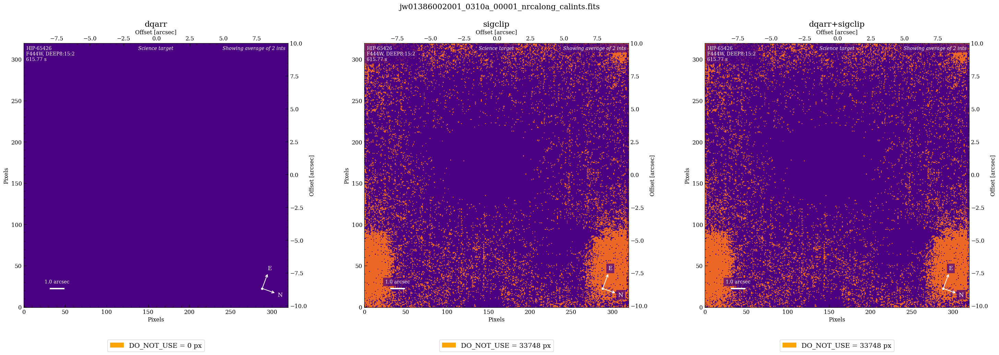

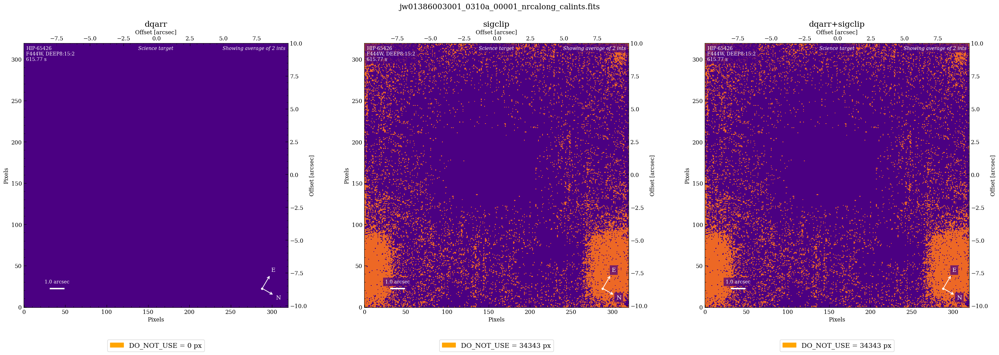

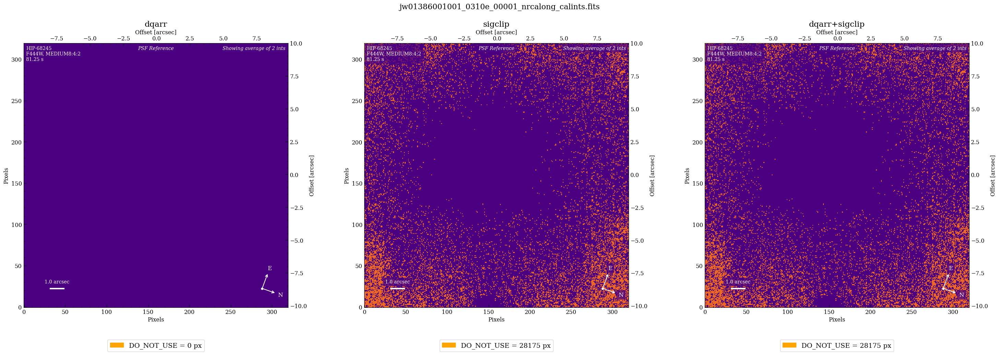

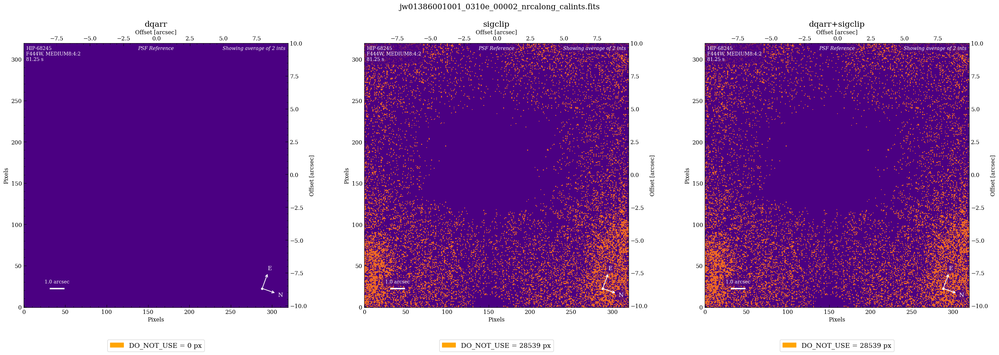

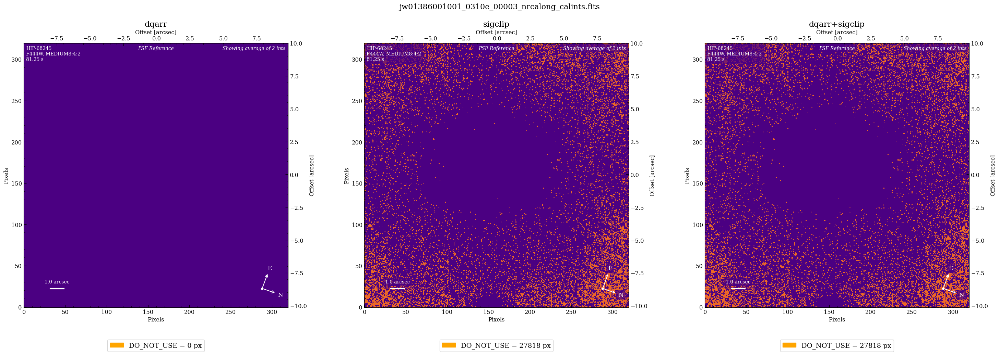

...

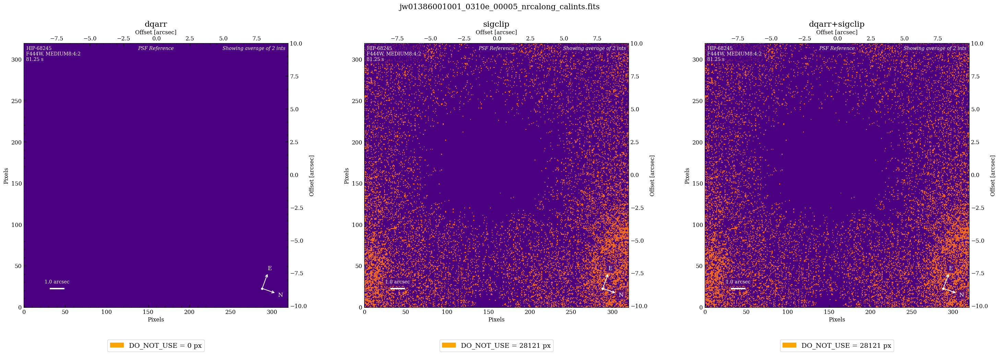

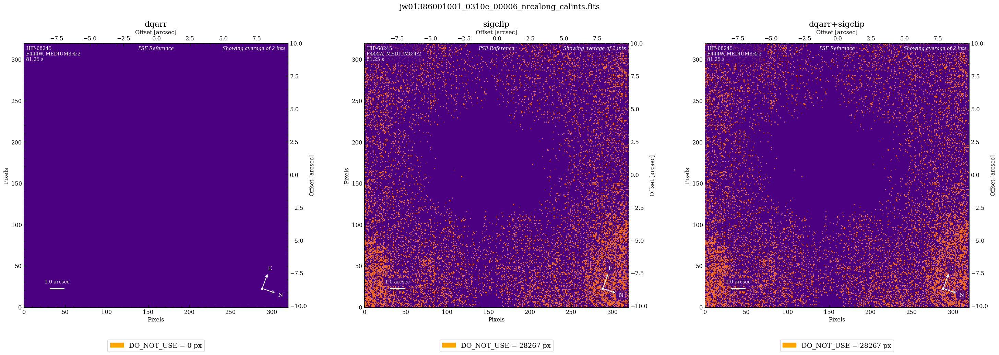

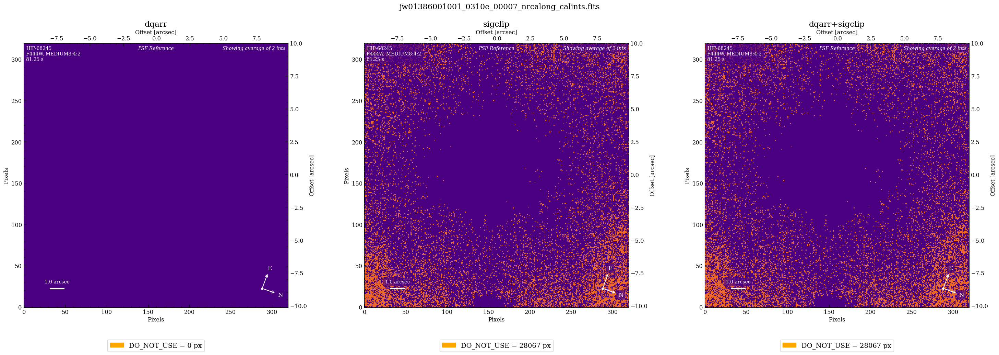

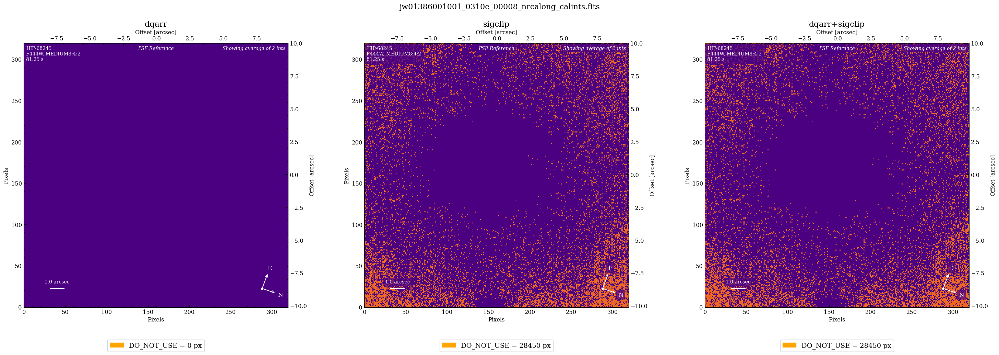

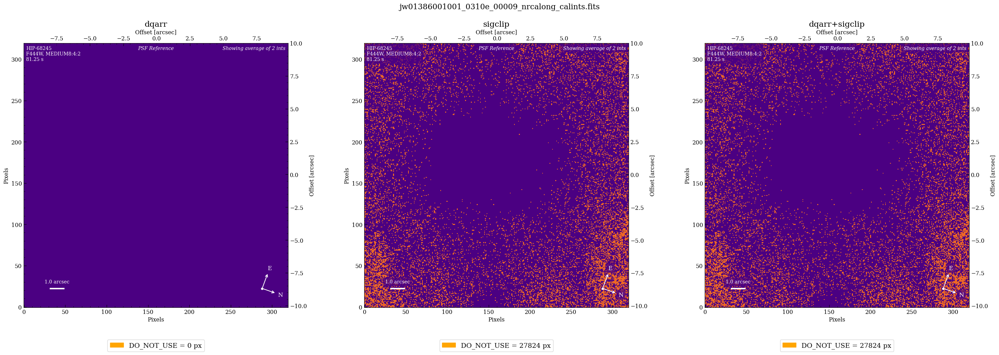

In [22]:
# Compare how well each method did to find bad pixels. 
display_image_comparisons(database, ['dqarr','sigclip', 'dqarr+sigclip'],
                          restrict_to=None, interact=False, dq_only=True,
                          save_filename='find_bp_f444w_comparison.pdf', 
                          vmin=0, vmax=10, a=0.00001) # Optional: Set the vmin/vmax/stretch 


Unlike the `find_bad_pixels` function, which starts with a blank slate before applying each method, the `clean_bad_pixels` function operates with a copy of the existing DQ array and applies the chosen cleaning methods sequentially. Each additional method refines the mask based on the previous result, leading to a progressively improved bad pixel mask. To observe the effects of each method individually, we apply each method separately rather than in the same run.


[spaceKLIP.imagetools:INFO] --> Concatenation JWST_NIRCAM_NRCALONG_F444W_MASKRND_MASK335R_SUB320A335R
[spaceKLIP.imagetools:INFO]   --> Method timemed: jw01386002001_0310a_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Method timemed: fixing 14340 bad pixel(s) -- 7.00%
[spaceKLIP.imagetools:INFO]   --> Method timemed: jw01386003001_0310a_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Method timemed: fixing 14321 bad pixel(s) -- 6.99%
[spaceKLIP.imagetools:INFO]   --> Method timemed: jw01386001001_0310e_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Method timemed: fixing 18813 bad pixel(s) -- 9.19%
[spaceKLIP.imagetools:INFO]   --> Method timemed: jw01386001001_0310e_00002_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Method timemed: fixing 19439 bad pixel(s) -- 9.49%
[spaceKLIP.imagetools:INFO]   --> Method timemed: jw01386001001_0310e_00003_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Method timemed: fixing 19566 bad p

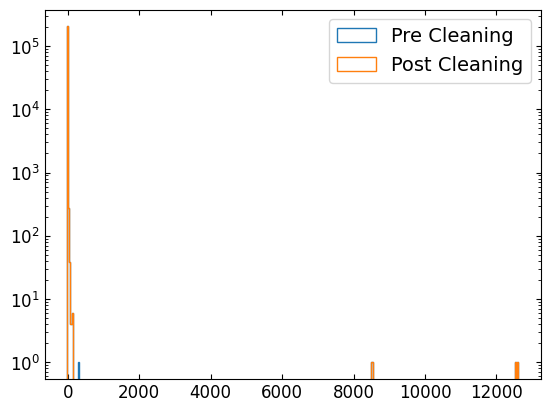

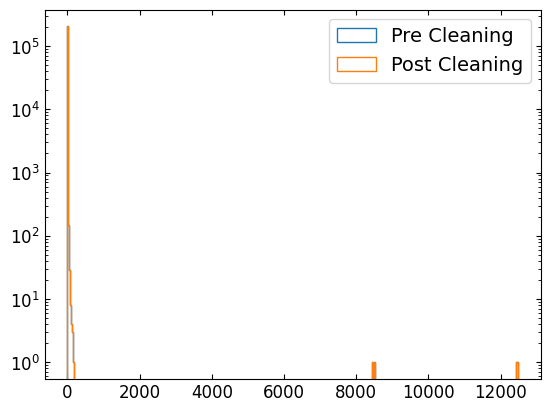

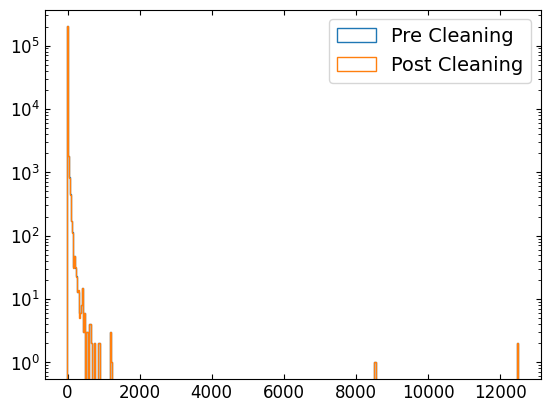

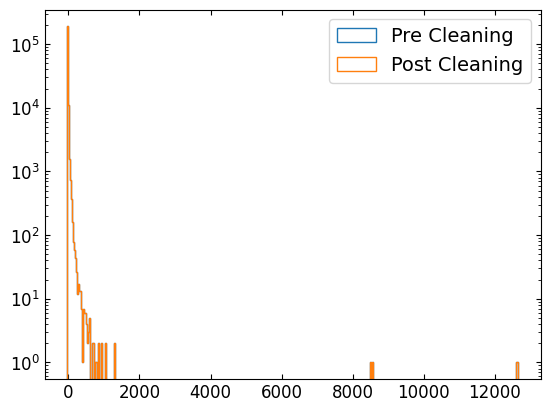

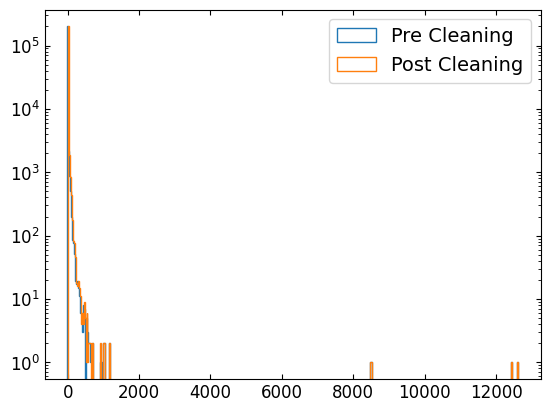

...

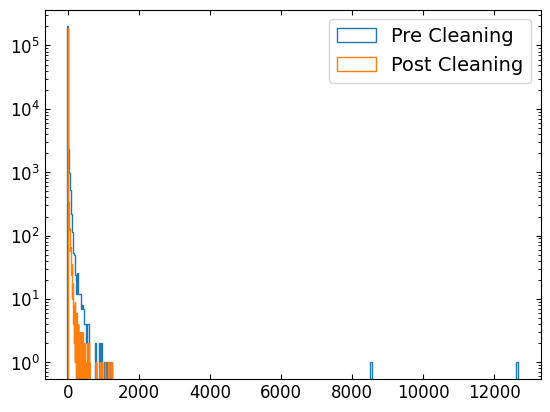

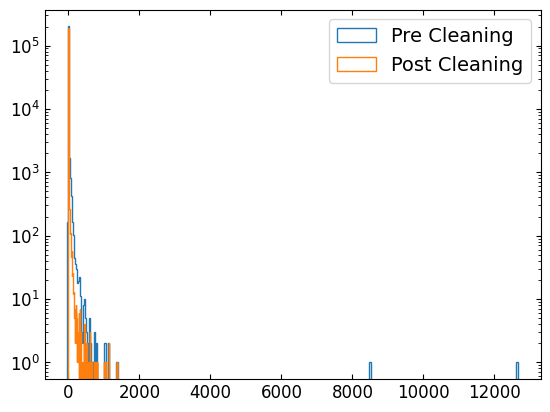

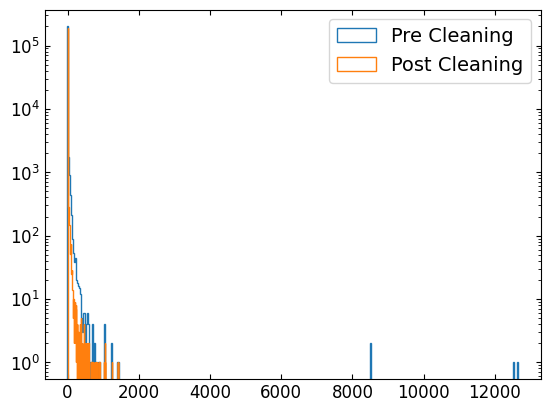

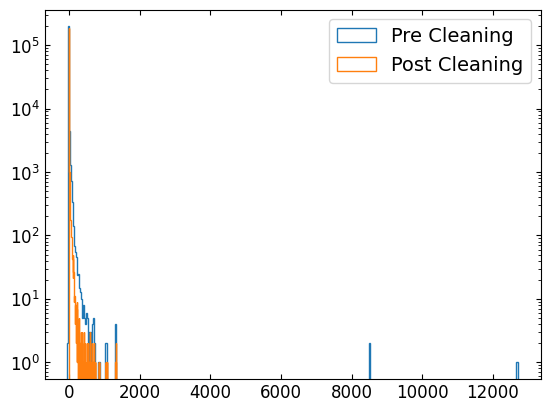

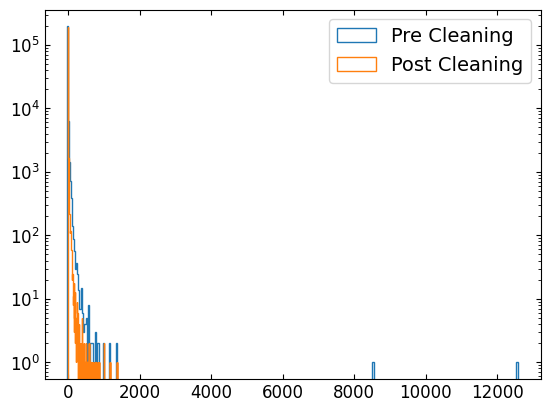

In [23]:
# On each iteration, apply a cleaning method to the 'dqarr+sigclip' bad pixel masks and 
# save results in method-specific directories. The database is updated after each iteration. 
for method in ['timemed', 'medfilt']:
    
    imageTools.clean_bad_pixels(method=method,
                                timemed_kwargs={},
                                medfilt_kwargs={'size': 4},
                                subdir=method)

Again, let's examine the results, but this time focusing on the cleaned products.



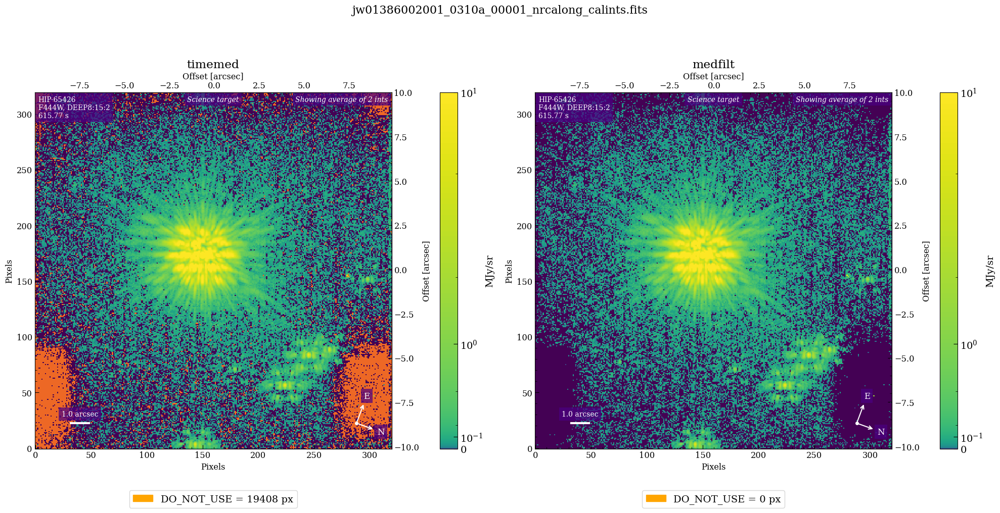

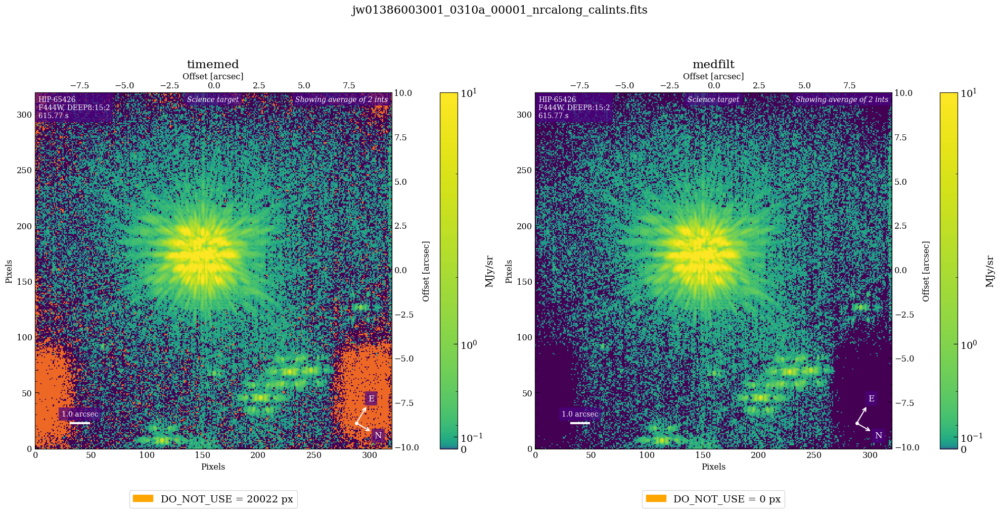

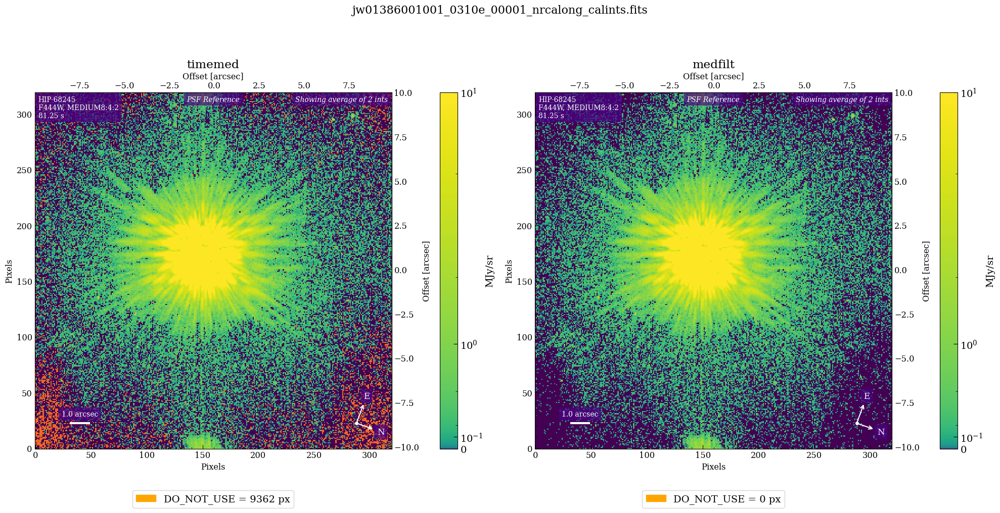

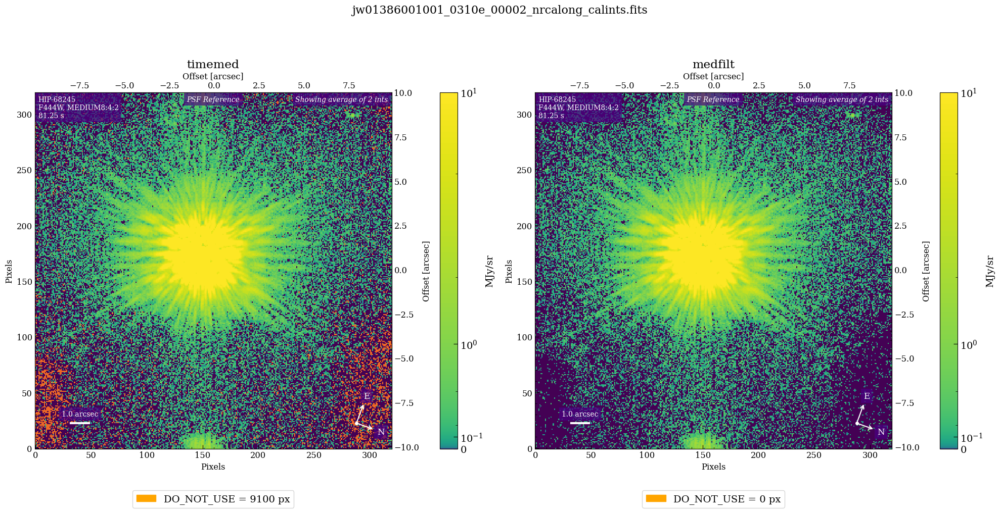

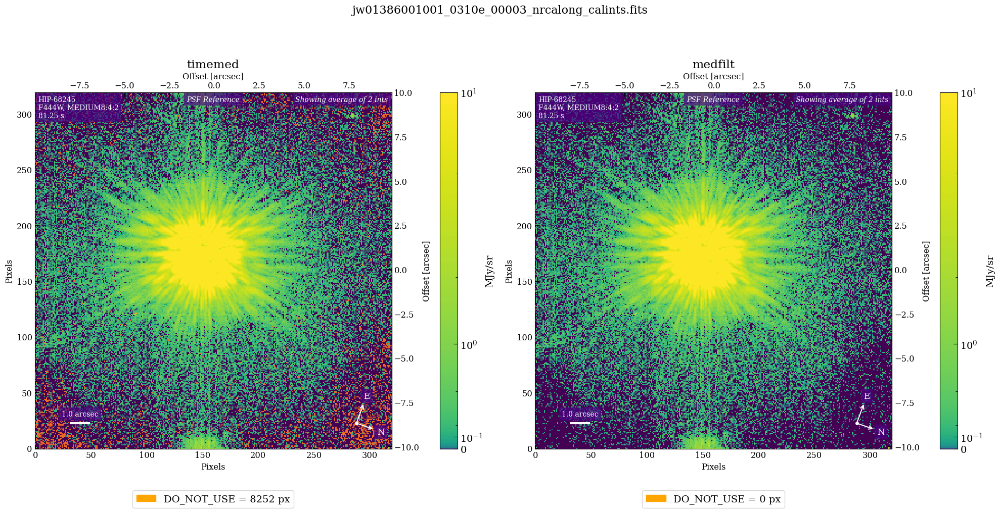

...

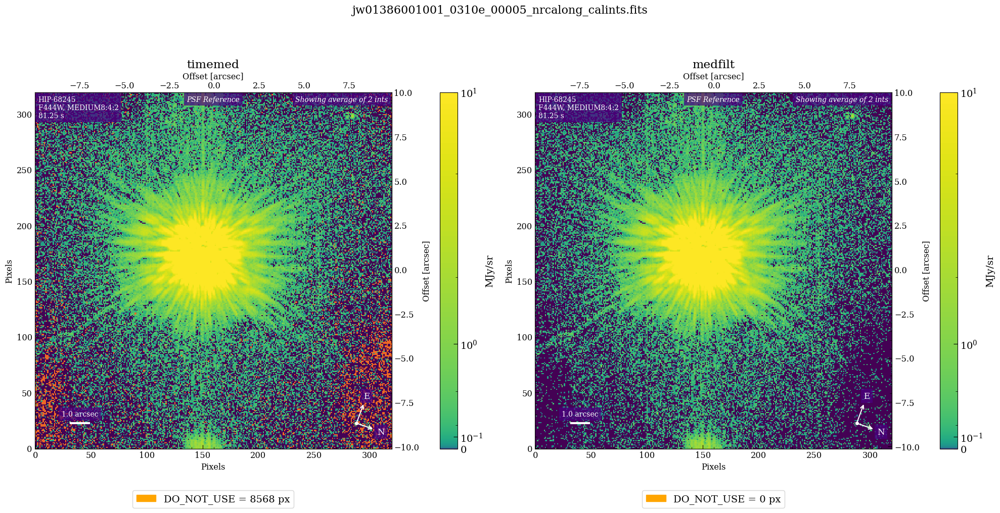

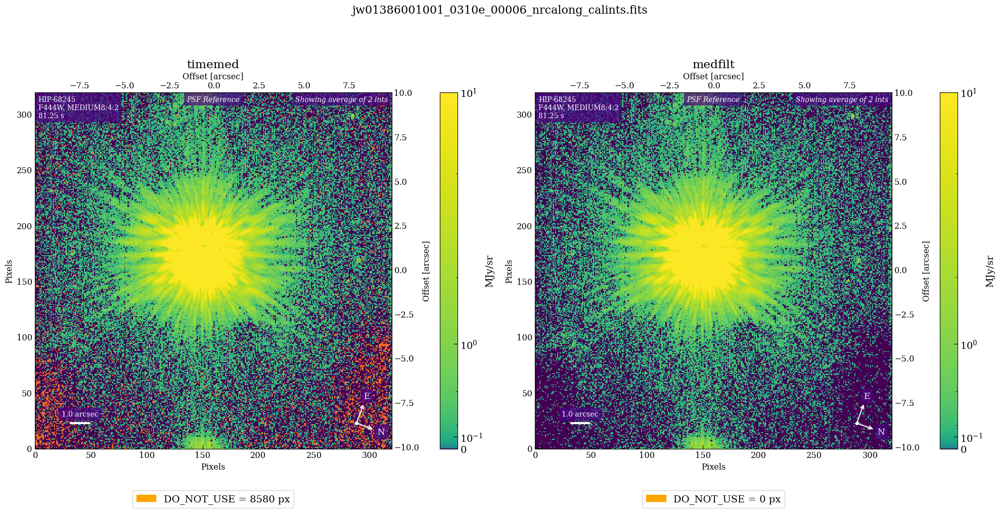

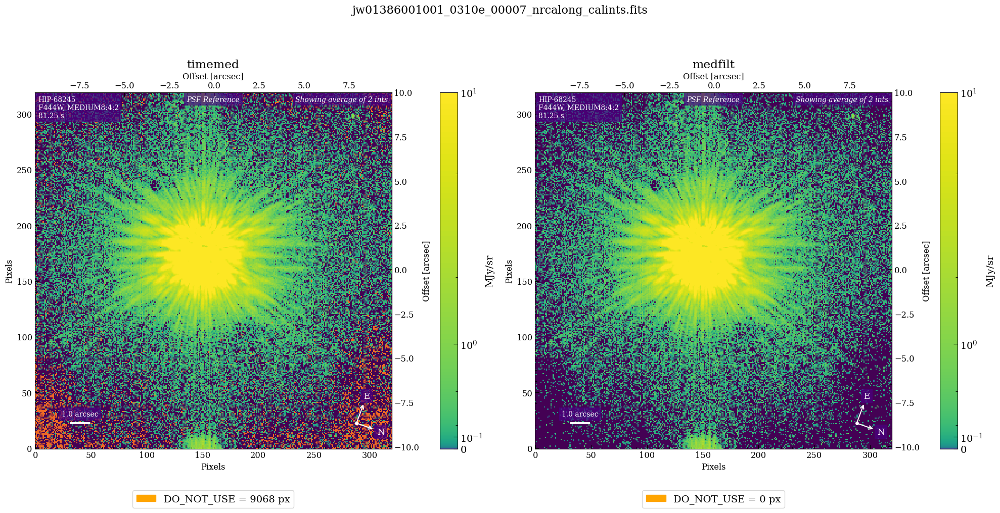

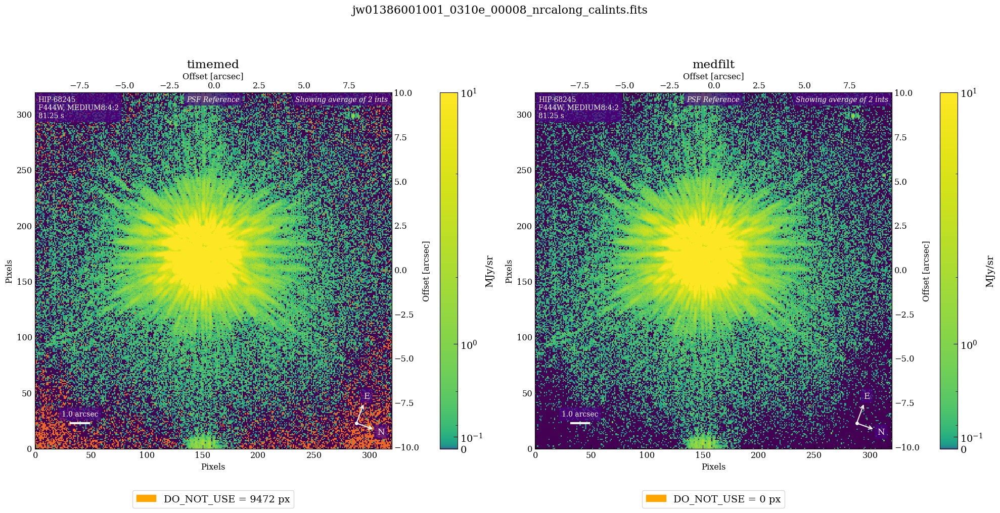

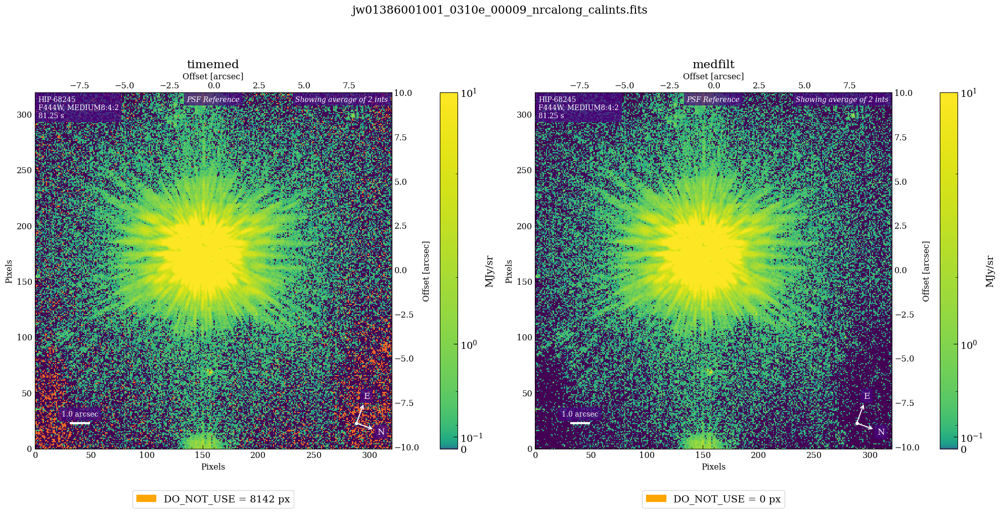

In [24]:
# Compare how well each cleaning method did to replace bad pixels. 
display_image_comparisons(database, ['timemed', 'medfilt'],
                          restrict_to=None, interact=False, dq_only=False,
                          save_filename='clean_bp_f444w_comparison.pdf', 
                          vmin=0, vmax=10, a=0.00001) # Optional: Set the vmin/vmax/stretch 


---

### Finish Pixel Cleanup

Optionally, any remaining bad pixels can be interpolated to replace NaNs with zeros.

In this case, this step is not strictly necessary since all the bad pixels have already been addressed in the previous steps. However, running this step for example purposes will not alter any pixel values, as they have already been fixed.

In [25]:
# Replace nans.
imageTools.replace_nans(cval=0., # Fill value. 
                        types=['SCI', 'SCI_BG', 'REF', 'REF_BG'],
                        subdir='nanreplaced')

[spaceKLIP.imagetools:INFO] --> Concatenation JWST_NIRCAM_NRCALONG_F444W_MASKRND_MASK335R_SUB320A335R
[spaceKLIP.imagetools:INFO]   --> Nan replacement: jw01386002001_0310a_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Nan replacement: replaced 0 nan pixel(s) with value 0.0 -- 0.00%
[spaceKLIP.imagetools:INFO]   --> Nan replacement: jw01386003001_0310a_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Nan replacement: replaced 0 nan pixel(s) with value 0.0 -- 0.00%
[spaceKLIP.imagetools:INFO]   --> Nan replacement: jw01386001001_0310e_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Nan replacement: replaced 0 nan pixel(s) with value 0.0 -- 0.00%
[spaceKLIP.imagetools:INFO]   --> Nan replacement: jw01386001001_0310e_00002_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Nan replacement: replaced 0 nan pixel(s) with value 0.0 -- 0.00%
[spaceKLIP.imagetools:INFO]   --> Nan replacement: jw01386001001_0310e_00003_nrcalong_calints.fits
[spaceK

---

### Improve PSF Centering and Alignment

In HCI, especially when using techniques like PSF subtraction, precise alignment of images is essential. Misalignment can introduce artifacts to the data, such as residual PSF structure and starlight, that interfere with detecting faint signals.

The alignment process for NIRCam data with spaceKLIP is broken down into the following steps: `update_center`, `recenter_frames`, and `align_frames`. 

<div class="alert alert-info">
    <b>NIRCam-specific information:</b> These steps for update_center, recenter_frames, align_frames are only recommended for use on NIRCam data at this time.  </div>

---

#### Update NIRCam PSF Center Metadata

This is an extra step to update header metadata for locations of the coronagraphs.

This uses a table of better center locations measured by Jarron Leisenring.
Replaces the header values for the CRPIX locations for the mask locations.

Eventually the more precise location inormation will be in [CRDS](https://jwst-crds.stsci.edu/) and this step will not be necessary. 

In [26]:
# This changes only the mask center information in the database table. No change in the observed data.

imageTools.update_nircam_centers()

[spaceKLIP.imagetools:INFO] --> Concatenation JWST_NIRCAM_NRCALONG_F444W_MASKRND_MASK335R_SUB320A335R
[spaceKLIP.imagetools:INFO]   --> Update NIRCam coronagraphy centers: jw01386002001_0310a_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Update NIRCam coronagraphy centers: old = (150.20, 174.60), new = (150.38, 174.39)
[spaceKLIP.imagetools:INFO]   --> Update NIRCam coronagraphy centers: jw01386003001_0310a_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Update NIRCam coronagraphy centers: old = (150.20, 174.60), new = (150.38, 174.39)
[spaceKLIP.imagetools:INFO]   --> Update NIRCam coronagraphy centers: jw01386001001_0310e_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Update NIRCam coronagraphy centers: old = (150.20, 174.60), new = (150.38, 174.39)
[spaceKLIP.imagetools:INFO]   --> Update NIRCam coronagraphy centers: jw01386001001_0310e_00002_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Update NIRCam coronagraphy centers: old =

---

### Re-center the Frames

Re-centering is an important pre-processing step, especially for NIRCam data. If we skip directly to the `align_frames` step without re-centering, we would assume that the CRPIX values in the header accurately reflect the star's precise location, which is also the KLIP center (the central position used for PSF modeling and subtraction). While this approach has been effective for instruments like MIRI, relying solely on CRPIX values can lead to inaccuracies for NIRCam due to uncertainties in the star's position behind the coronagraph, and therefore in the KLIP center.

To better measure the location of the star with respect to the coronagraph, we create a simulation of the star behind the coronagraph (using webbpsf), and cross-correlate this with the observed PSF. The cross correlation peak is used to infer the offset of the star relative to the mask center. The measured offset is used to shift the first frame to be centered. An identical shift is applied to subsequent frames to prepare them for the align_frames step. 

The accuracy of this algorithm is around 7 milliarcsec according to testing. 

This step also shifts to account for the coronagraph not being precisely centered in the subarray. After this step, the star center will be at the center of the pixel. 

In [27]:
imageTools.recenter_frames(spectral_type='A2V')  

# The spectral type is used to make a more accurate PSF simulation for the star.
# This step changes the pixel data in the first science frame to center it.
# The other subsequent frames are shifted identically. I.e. the shift to center the first SCI frame
# is applied to all SCI and REF frames. 

[spaceKLIP.imagetools:INFO] --> Concatenation JWST_NIRCAM_NRCALONG_F444W_MASKRND_MASK335R_SUB320A335R
[spaceKLIP.imagetools:INFO]   --> Recenter frames: jw01386002001_0310a_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Recenter frames: generating WebbPSF image for absolute centering (this might take a while)
[spaceKLIP.psf:INFO] Generating on-axis and off-axis PSFs...
[spaceKLIP.psf:INFO]   Done.
[spaceKLIP.imagetools:INFO]   --> Recenter frames: star offset from coronagraph center (dx, dy) = (0.12, -0.25) pix
[spaceKLIP.imagetools:INFO]  Plot saved in data_nircam_hd65426/recentered/JWST_NIRCAM_NRCALONG_F444W_MASKRND_MASK335R_SUB320A335R_recenter.pdf
[spaceKLIP.imagetools:INFO]   --> Recenter frames: jw01386002001_0310a_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Recenter frames: median required shift = 1050.12 mas
[spaceKLIP.imagetools:INFO]   --> Recenter frames: jw01386003001_0310a_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Recent

This step saves output PDFs with plots showing the centering information results. 

In [28]:
!ls data_nircam_hd65426/recentered/*pdf

data_nircam_hd65426/recentered/JWST_NIRCAM_NRCALONG_F444W_MASKRND_MASK335R_SUB320A335R_recenter.pdf
data_nircam_hd65426/recentered/jw01386002001_0310a_00001_nrcalong_calints.pdf


In [29]:
# Optional, open one of the plots to view it. (note, use of !open assumes you are running this on Mac OS)

!open data_nircam_hd65426/recentered/JWST_NIRCAM_NRCALONG_F444W_MASKRND_MASK335R_SUB320A335R_recenter.pdf

---

### Align Frames

When re-centering, a constant offset was applied to ensure the star's position was centered relative to the coronagraph mask. However, this step only adjusts each frame independently based on the offset. Consequently, the frames may not be perfectly aligned with one other, meaning the star might not occupy the exact same pixel coordinates in every frame.

To achieve precise alignment across all frames, we use the `align_frames` function. This function calculates the exact shifts to the image pixel data needed to align each frame with the first frame of the first science integration (i.e., the second roll and all references are aligned to the first roll). 

In [30]:
# Align Frames Use image registration to align all frames in a concatenation to the
# first science frame in that concatenation.
imageTools.align_frames(method='fourier',
                        kwargs={},
                        subdir='aligned')

[spaceKLIP.imagetools:INFO] --> Concatenation JWST_NIRCAM_NRCALONG_F444W_MASKRND_MASK335R_SUB320A335R
[spaceKLIP.imagetools:INFO]   --> Align frames: jw01386002001_0310a_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Align frames: median required shift = 0.33 mas
[spaceKLIP.imagetools:INFO]   --> Align frames: jw01386003001_0310a_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Align frames: median required shift = 13.24 mas
[spaceKLIP.imagetools:INFO]   --> Align frames: jw01386001001_0310e_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Align frames: median required shift = 17.12 mas
[spaceKLIP.imagetools:INFO]   --> Align frames: jw01386001001_0310e_00002_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Align frames: median required shift = 37.09 mas
[spaceKLIP.imagetools:INFO]   --> Align frames: jw01386001001_0310e_00003_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Align frames: median required shift = 29.35 mas
[spaceKLI

In [31]:
# This step also outputs plots that show the results of the alignment

!ls data_nircam_hd65426/aligned/*pdf

data_nircam_hd65426/aligned/JWST_NIRCAM_NRCALONG_F444W_MASKRND_MASK335R_SUB320A335R_align_ref.pdf
data_nircam_hd65426/aligned/JWST_NIRCAM_NRCALONG_F444W_MASKRND_MASK335R_SUB320A335R_align_sci.pdf


In [32]:
# Open one to view the alignment of the reference images.
!open data_nircam_hd65426/aligned/JWST_NIRCAM_NRCALONG_F444W_MASKRND_MASK335R_SUB320A335R_align_ref.pdf


Now, let’s compare the re-centered images with the aligned images relative to the first science frame.







<Figure size 3000x1000 with 0 Axes>

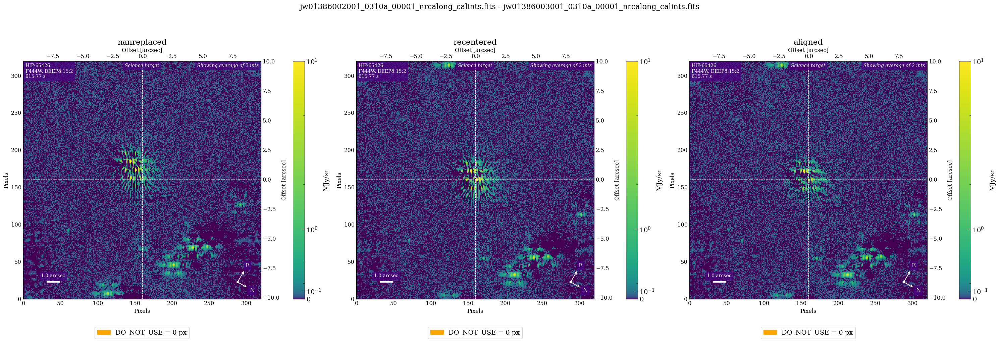

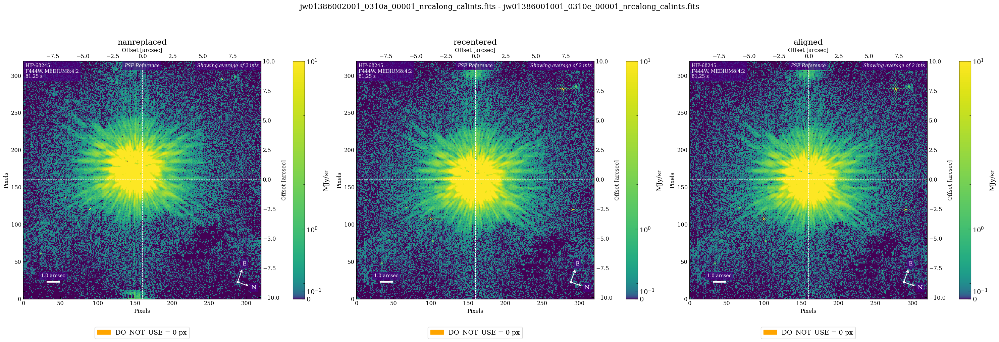

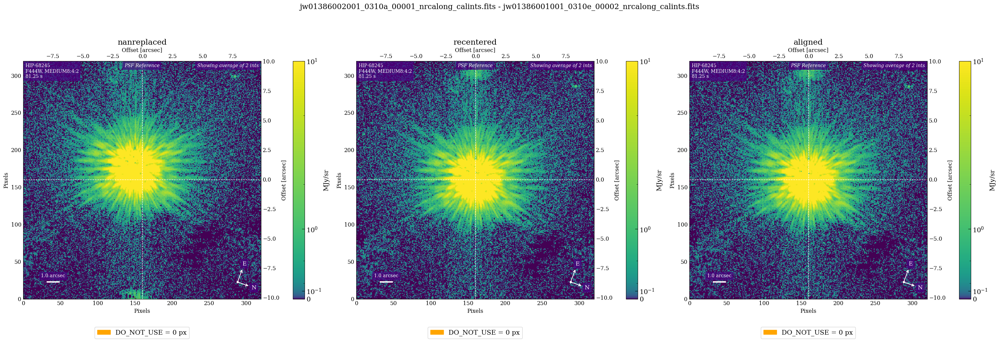

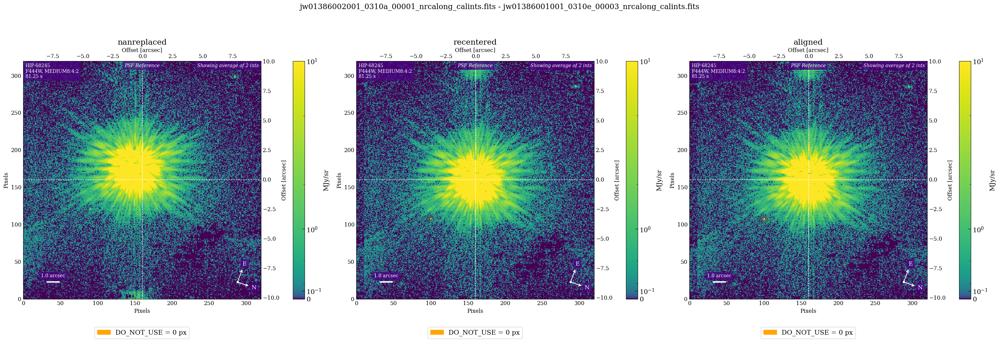

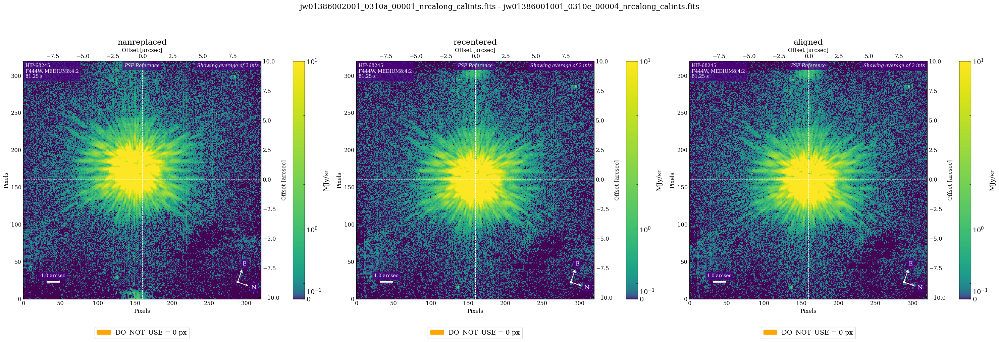

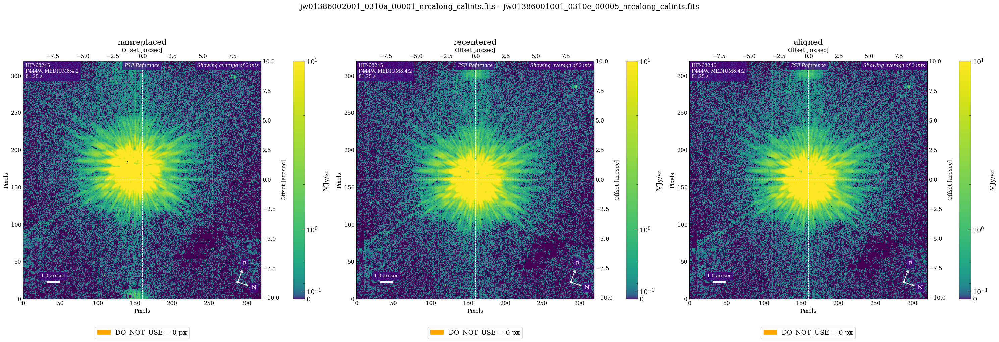

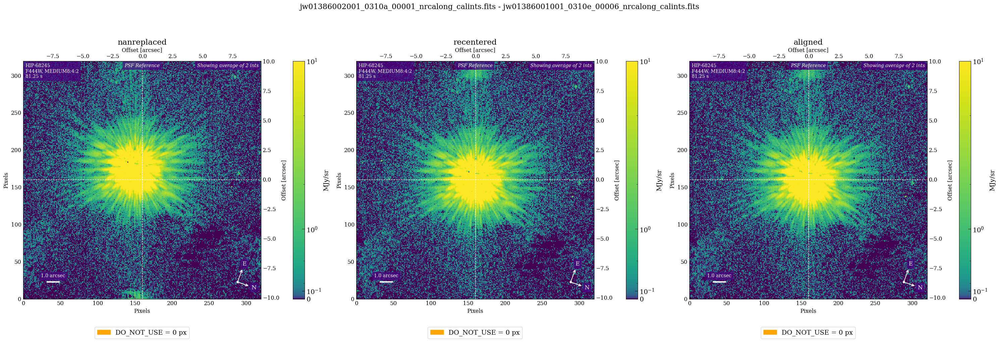

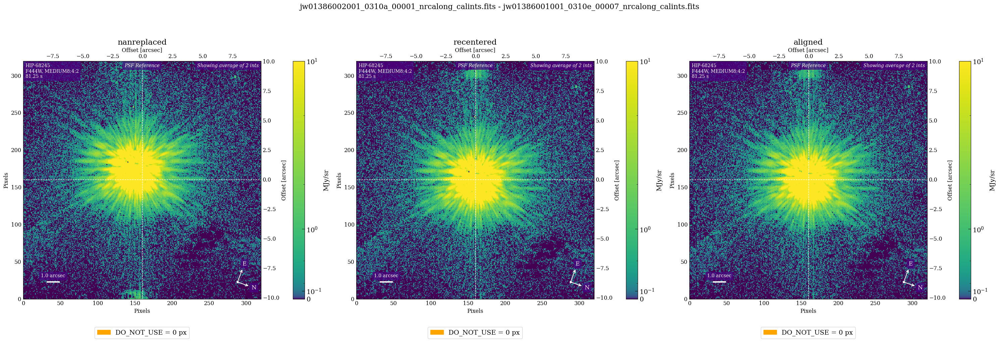

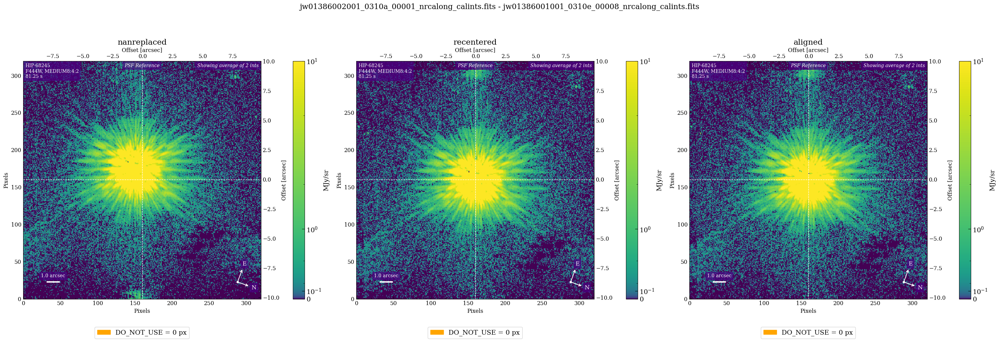

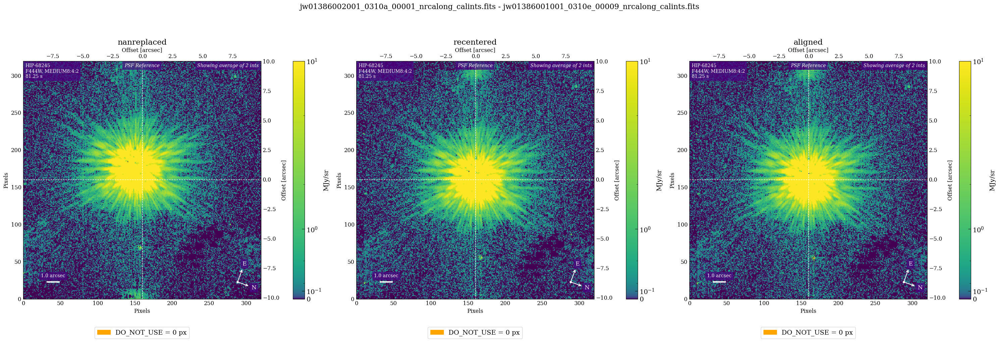

In [34]:
# Compare how well each cleaning method did to replace bad pixels. 
display_image_comparisons(database, ['nanreplaced', 'recentered', 'aligned'],
                          restrict_to=None, interact=False, dq_only=False,
                          save_filename='recenter_vs_align_f444w_comparison.pdf', 
                          subtract_first=True, 
                          vmin=0, vmax=10, a=0.001) # Optional: Set the vmin/vmax/stretch 


---

### Pad Empty Space Around Frames

To give space to rotate and align during pyklip. This puts a region of NAN pixels around the outside. 

In [35]:
# Pad all frames.
imageTools.pad_frames(npix=80,
                      cval=np.nan,
                      types=['SCI', 'SCI_BG', 'REF', 'REF_BG'],
                      subdir='padded')

[spaceKLIP.imagetools:INFO] --> Concatenation JWST_NIRCAM_NRCALONG_F444W_MASKRND_MASK335R_SUB320A335R
[spaceKLIP.imagetools:INFO]   --> Frame padding: jw01386002001_0310a_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Frame padding: old shape = (320, 320), new shape = (480, 480), fill value = nan
[spaceKLIP.imagetools:INFO]   --> Frame padding: jw01386003001_0310a_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Frame padding: old shape = (320, 320), new shape = (480, 480), fill value = nan
[spaceKLIP.imagetools:INFO]   --> Frame padding: jw01386001001_0310e_00001_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Frame padding: old shape = (320, 320), new shape = (480, 480), fill value = nan
[spaceKLIP.imagetools:INFO]   --> Frame padding: jw01386001001_0310e_00002_nrcalong_calints.fits
[spaceKLIP.imagetools:INFO]   --> Frame padding: old shape = (320, 320), new shape = (480, 480), fill value = nan
[spaceKLIP.imagetools:INFO]   --> Frame padding: jw013

---

### Display the Cleaned Datasets 

After applying all the previous steps, review the cleaned data. If you notice artifacts near bad pixels, it is likely that some were not identified and have persisted. To address this, you may need to revisit the bad pixel identification process, adjust the parameters, or add a custom bad pixel map. ** Also discuss image wrapping, to be addressed. 



In [ ]:
spaceKLIP.plotting.display_coron_dataset(database, 
                                         restrict_to='F444W', 
                                         save_filename='plots_f444w_stage2_cleaned.pdf')

In [37]:
!open plots_f444w_stage2_cleaned.pdf

---

## Level 3 Reductions: KLIP

### PSF Subtraction: Option Using pyKLIP

Now that we have cleaned up our data to account for alignment and bad pixels, we are ready to perform PSF subtraction. SpaceKLIP supports several algorithms for this step, including the recommended [`pyKLIP`](https://pyklip.readthedocs.io/en/latest/index.html) and the JWST [`Coron3Pipeline`](https://jwst-pipeline.readthedocs.io/en/latest/api/jwst.pipeline.Coron3Pipeline.html). In this case, we will use pyKLIP for subtraction.

You can customize the PSF subtraction process by adjusting the following settings:

> * `mode`: Choose from different image processing techniques, such as ADI, RDI, or a combination of both.
> * `annuli`: This parameter determines the number of concentric ring-shaped regions used for PSF subtraction. By specifying different numbers of annuli, you control the radial regions where the subtraction is applied, helping to remove the PSF at various distances from the center of the star. Default is [1].
> * `subsections`: This parameter defines the number of smaller regions or segments within each annulus where the PSF subtraction is applied. By breaking down the annuli into subsections, the algorithm can fine-tune the subtraction process. The default value is [1].
> * Number of KL Modes (`numbasis`): This parameter specifies how many Principal Component Analysis (PCA) modes are used to build the PSF model for subtraction. PCA modes capture different patterns and features in the data, allowing the model to represent and subtract the PSF more accurately. The default values are [1, 2, 5, 10, 20, 50, 100], which allows us to test different PSF models.
> * `algo`: Select the processing algorithm (here, klip).
> * `save_rolls`: A roll refers to a set of images taken during a specific pointing direction or orientation of the telescope. Enabling this parameter will save the PSF-subtracted versions of each individual science roll separately, in addition to the roll-combined final product.







These options help tailor the analysis to better suit your specific data and objectives.

In [38]:
# Run pyKLIP pipeline. Additional parameters for klip_dataset function can
# be passed using kwargs parameter.
spaceKLIP.pyklippipeline.run_obs(database=database,
                       kwargs={'mode': ['ADI', 'RDI', 'ADI+RDI'],
                               'annuli': [1, 5],
                               'subsections': [1],
                               'numbasis': [1, 2, 5, 10, 20, 50],
                               'algo': 'klip',
                               'save_rolls': True},
                       subdir='klipsub')


[spaceKLIP.pyklippipeline:INFO] --> Concatenation JWST_NIRCAM_NRCALONG_F444W_MASKRND_MASK335R_SUB320A335R
[spaceKLIP.pyklippipeline:INFO]   --> pyKLIP: mode = ADI, annuli = 1, subsections = 1
Begin align and scale images for each wavelength
Wavelength 4.439e-06 with index 0 has finished align and scale. Queuing for KLIP
Total number of tasks for KLIP processing is 1


  0%|          | 0/1 [00:00<?, ?it/s]

Closing threadpool
Derotating Images...
Writing Images to directory /System/Volumes/Data/user/kglidic/spaceKLIP_Testing/data_nircam_hd65426/klipsub
wavelength collapsing reduced data of shape (b, N, wv, y, x):(6, 4, 1, 480, 480)
[spaceKLIP.pyklippipeline:INFO]   --> pyKLIP: mode = ADI, annuli = 5, subsections = 1
Begin align and scale images for each wavelength
Wavelength 4.439e-06 with index 0 has finished align and scale. Queuing for KLIP
Total number of tasks for KLIP processing is 5


  0%|          | 0/5 [00:00<?, ?it/s]

Closing threadpool
section is too small (0 pixels), skipping...


/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/pyklip/parallelized.py:453: RuntimeWarning: Mean of empty slice
  ref_psfs_mean_sub = ref_psfs - np.nanmean(ref_psfs, axis=1)[:, None]
/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/pyklip/klip.py:112: RuntimeWarning: Mean of empty slice
  sci_mean_sub = sci - np.nanmean(sci)
/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/pyklip/klip.py:157: RuntimeWarning: divide by zero encountered in divide
  kl_basis = kl_basis * (1. / np.sqrt(evals * (np.size(sci) - 1)))[None, :]  #multiply a value for each row
/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/pyklip/klip.py:157: RuntimeWarning: invalid value encountered in multiply
  kl_basis = kl_basis * (1. / np.sqrt(evals * (np.size(sci) - 1)))[None, :]  

Derotating Images...
Writing Images to directory /System/Volumes/Data/user/kglidic/spaceKLIP_Testing/data_nircam_hd65426/klipsub
wavelength collapsing reduced data of shape (b, N, wv, y, x):(6, 4, 1, 480, 480)
[spaceKLIP.pyklippipeline:INFO]   --> pyKLIP: mode = RDI, annuli = 1, subsections = 1
Begin align and scale images for each wavelength
Wavelength 4.439e-06 with index 0 has finished align and scale. Queuing for KLIP
Total number of tasks for KLIP processing is 1


  0%|          | 0/1 [00:00<?, ?it/s]

Closing threadpool
Derotating Images...
Writing Images to directory /System/Volumes/Data/user/kglidic/spaceKLIP_Testing/data_nircam_hd65426/klipsub
wavelength collapsing reduced data of shape (b, N, wv, y, x):(6, 4, 1, 480, 480)
[spaceKLIP.pyklippipeline:INFO]   --> pyKLIP: mode = RDI, annuli = 5, subsections = 1
Begin align and scale images for each wavelength
Wavelength 4.439e-06 with index 0 has finished align and scale. Queuing for KLIP
Total number of tasks for KLIP processing is 5


  0%|          | 0/5 [00:00<?, ?it/s]

/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/pyklip/parallelized.py:453: RuntimeWarning: Mean of empty slice
  ref_psfs_mean_sub = ref_psfs - np.nanmean(ref_psfs, axis=1)[:, None]
/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/pyklip/parallelized.py:695: RuntimeWarning: Mean of empty slice
  rdi_psfs_selected = rdi_psfs_selected - np.nanmean(rdi_psfs_selected, axis=1)[:, None]
/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/pyklip/klip.py:112: RuntimeWarning: Mean of empty slice
  sci_mean_sub = sci - np.nanmean(sci)
/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/pyklip/klip.py:157: RuntimeWarning: divide by zero encountered in divide
  kl_basis = kl_basis * (1. / np.sqrt(evals * (np.size(sci) - 1)))[None, :]  #multiply a value for each ro

Closing threadpool
section is too small (0 pixels), skipping...
Derotating Images...
Writing Images to directory /System/Volumes/Data/user/kglidic/spaceKLIP_Testing/data_nircam_hd65426/klipsub
wavelength collapsing reduced data of shape (b, N, wv, y, x):(6, 4, 1, 480, 480)
[spaceKLIP.pyklippipeline:INFO]   --> pyKLIP: mode = ADI+RDI, annuli = 1, subsections = 1
Begin align and scale images for each wavelength
Wavelength 4.439e-06 with index 0 has finished align and scale. Queuing for KLIP
Total number of tasks for KLIP processing is 1


  0%|          | 0/1 [00:00<?, ?it/s]

Closing threadpool
Derotating Images...
Writing Images to directory /System/Volumes/Data/user/kglidic/spaceKLIP_Testing/data_nircam_hd65426/klipsub
wavelength collapsing reduced data of shape (b, N, wv, y, x):(6, 4, 1, 480, 480)
[spaceKLIP.pyklippipeline:INFO]   --> pyKLIP: mode = ADI+RDI, annuli = 5, subsections = 1
Begin align and scale images for each wavelength
Wavelength 4.439e-06 with index 0 has finished align and scale. Queuing for KLIP
Total number of tasks for KLIP processing is 5


  0%|          | 0/5 [00:00<?, ?it/s]

/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/pyklip/parallelized.py:453: RuntimeWarning: Mean of empty slice
  ref_psfs_mean_sub = ref_psfs - np.nanmean(ref_psfs, axis=1)[:, None]
/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/numpy/lib/function_base.py:2897: RuntimeWarning: invalid value encountered in divide
  c /= stddev[:, None]
/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/pyklip/parallelized.py:695: RuntimeWarning: Mean of empty slice
  rdi_psfs_selected = rdi_psfs_selected - np.nanmean(rdi_psfs_selected, axis=1)[:, None]
/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/pyklip/klip.py:112: RuntimeWarning: Mean of empty slice
  sci_mean_sub = sci - np.nanmean(sci)
/Users/kglidic/miniconda3/envs/sklip/lib/python3.12/site-packages/pyklip/klip.py:157: RuntimeWarning: divide by zero encountered in divide
  kl_basis = kl_basis * (1. / np.sqrt(evals * (np.size(sci) - 1)))[None, :]  #multiply a value for each ro

Closing threadpool
section is too small (0 pixels), skipping...
Derotating Images...
Writing Images to directory /System/Volumes/Data/user/kglidic/spaceKLIP_Testing/data_nircam_hd65426/klipsub
wavelength collapsing reduced data of shape (b, N, wv, y, x):(6, 4, 1, 480, 480)
[spaceKLIP.database:INFO] --> Identified 1 concatenation(s)
[spaceKLIP.database:INFO]   --> Concatenation 1: JWST_NIRCAM_NRCALONG_F444W_MASKRND_MASK335R_SUB320A335R
 TYPE   EXP_TYPE DATAMODL TELESCOP ... SUBSECTS    KLMODES     BUNIT  BLURFWHM
------ --------- -------- -------- ... -------- -------------- ------ --------
PYKLIP NRC_CORON   STAGE3     JWST ...        1 1,2,5,10,20,50 MJy/sr      nan
PYKLIP NRC_CORON   STAGE3     JWST ...        1 1,2,5,10,20,50 MJy/sr      nan
PYKLIP NRC_CORON   STAGE3     JWST ...        1 1,2,5,10,20,50 MJy/sr      nan
PYKLIP NRC_CORON   STAGE3     JWST ...        1 1,2,5,10,20,50 MJy/sr      nan
PYKLIP NRC_CORON   STAGE3     JWST ...        1 1,2,5,10,20,50 MJy/sr      nan
PYKLIP N

The stage 3 information in the database is added to another table. The stage 2 information remains in the database, which is needed to maintain the information on rolls and references used in the reduction for forward modeling. 
In fact the stage 3 outputs include a JSON file that includes the table of the stage 2 data, so if you read in the stage 3 outputs it also learns about the stage 2 inputs.

In [39]:
database.summarize()

NIRCAM_F444W_MASK335R
	STAGE2: 11 files;	2 SCI, 9 REF
	STAGE3: 6 files;	6 PYKLIP


---

### Optional: Re-read Level 3 Outputs into Database 
This shows how you can start re-analyses at this point, once you have run the previous steps.

Note, to read in level 3 data you must set the `readlevel` parameter to 3. This invokes code for reading the level-3 formatted data products, and also implicitly reads in the metadata about the stage 2 files used as input to stage 3. 

In [40]:
database = spaceKLIP.database.create_database(input_dir = os.path.join(data_root, 'klipsub'),
                                              file_type='*KLmodes-all.fits.fits',
                                              output_dir=data_root,
                                              readlevel=3,
                                              pid=1386)

[spaceKLIP.database:INFO] --> Identified 1 concatenation(s)
[spaceKLIP.database:INFO]   --> Concatenation 1: JWST_NIRCAM_NRCALONG_F444W_MASKRND_MASK335R_SUB320A335R
 TYPE   EXP_TYPE DATAMODL TELESCOP ... SUBSECTS    KLMODES     BUNIT  BLURFWHM
------ --------- -------- -------- ... -------- -------------- ------ --------
PYKLIP NRC_CORON   STAGE3     JWST ...        1 1,2,5,10,20,50 MJy/sr      nan
PYKLIP NRC_CORON   STAGE3     JWST ...        1 1,2,5,10,20,50 MJy/sr      nan
PYKLIP NRC_CORON   STAGE3     JWST ...        1 1,2,5,10,20,50 MJy/sr      nan
PYKLIP NRC_CORON   STAGE3     JWST ...        1 1,2,5,10,20,50 MJy/sr      nan
PYKLIP NRC_CORON   STAGE3     JWST ...        1 1,2,5,10,20,50 MJy/sr      nan
PYKLIP NRC_CORON   STAGE3     JWST ...        1 1,2,5,10,20,50 MJy/sr      nan


In [41]:
database.summarize()

NIRCAM_F444W_MASK335R
	STAGE2: 11 files;	2 SCI, 9 REF
	STAGE3: 6 files;	6 PYKLIP


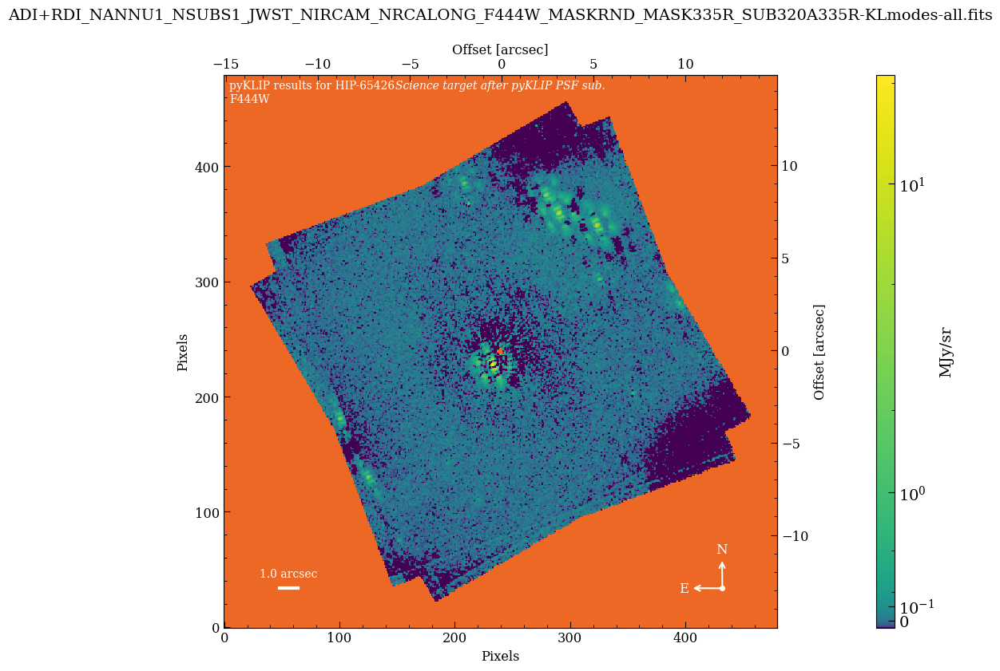

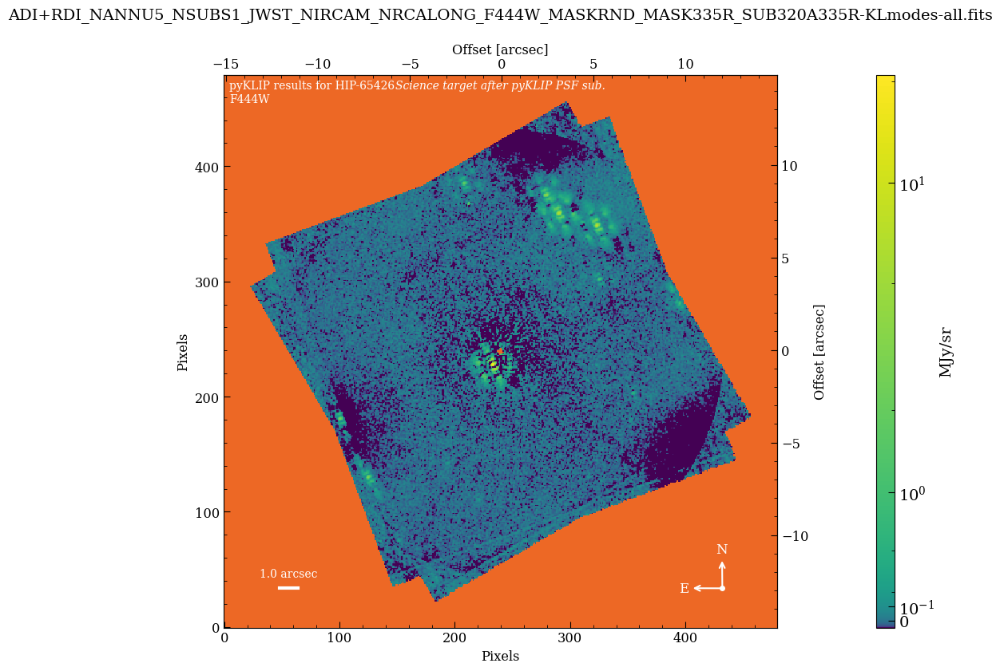

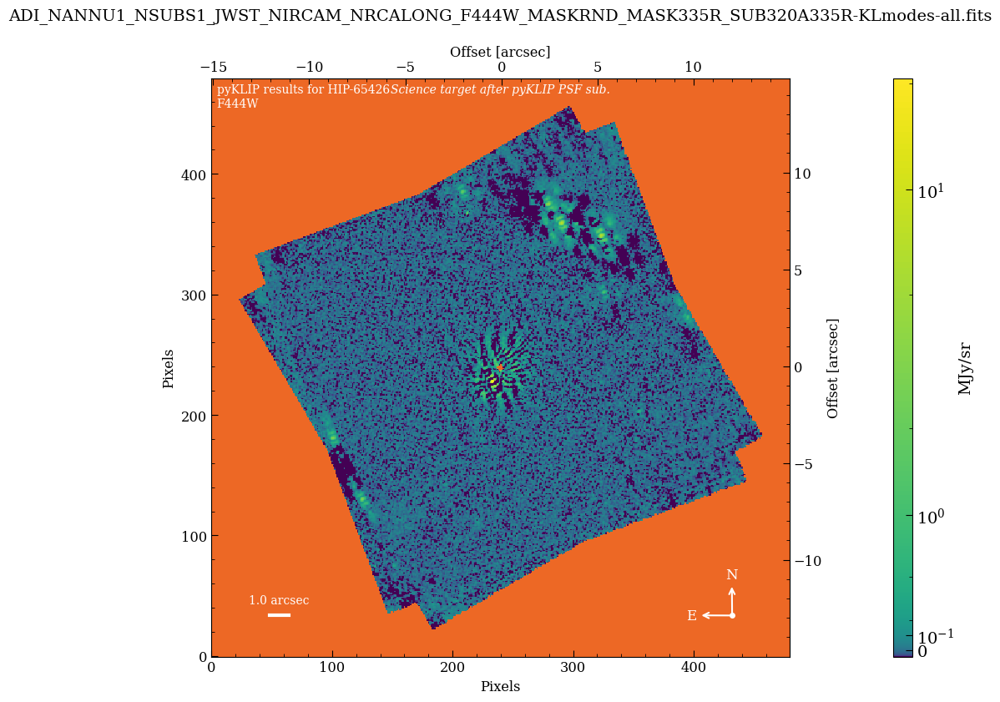

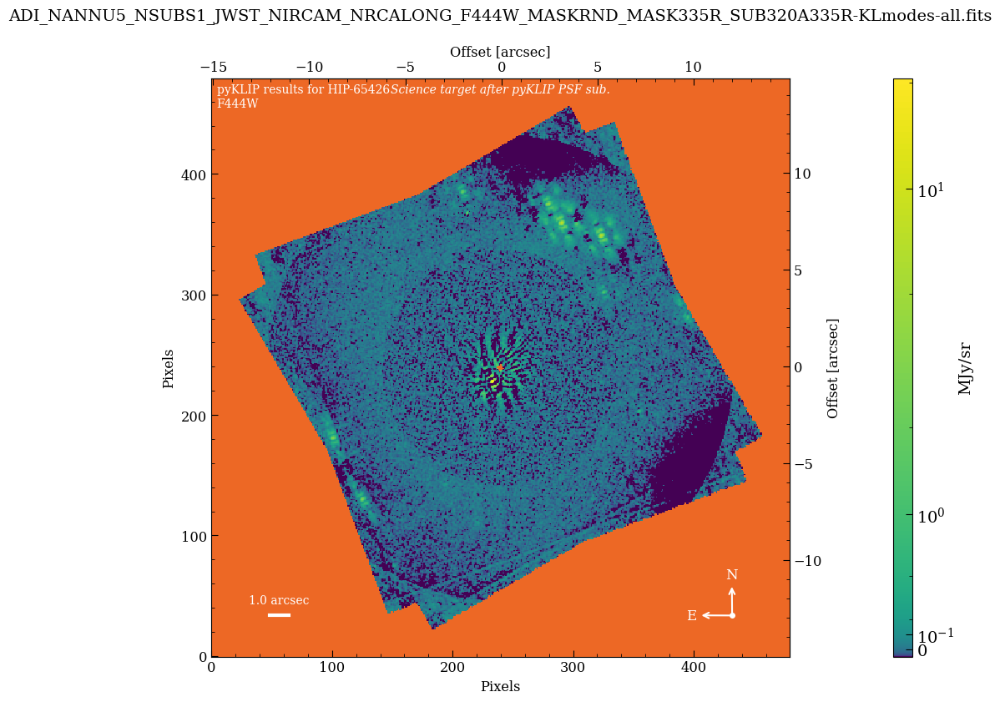

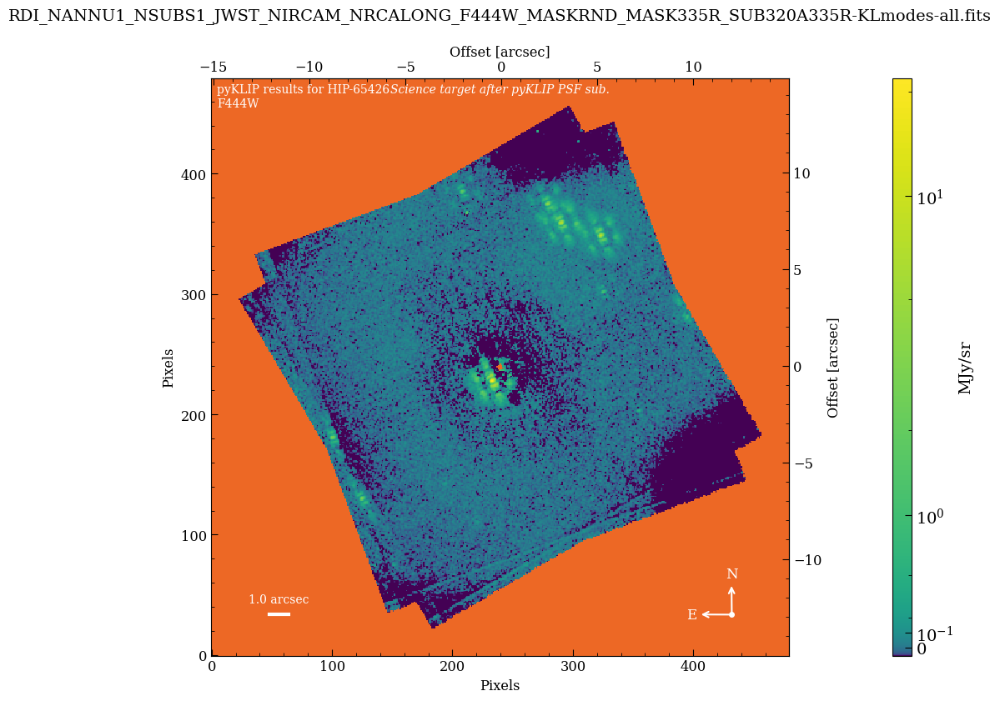

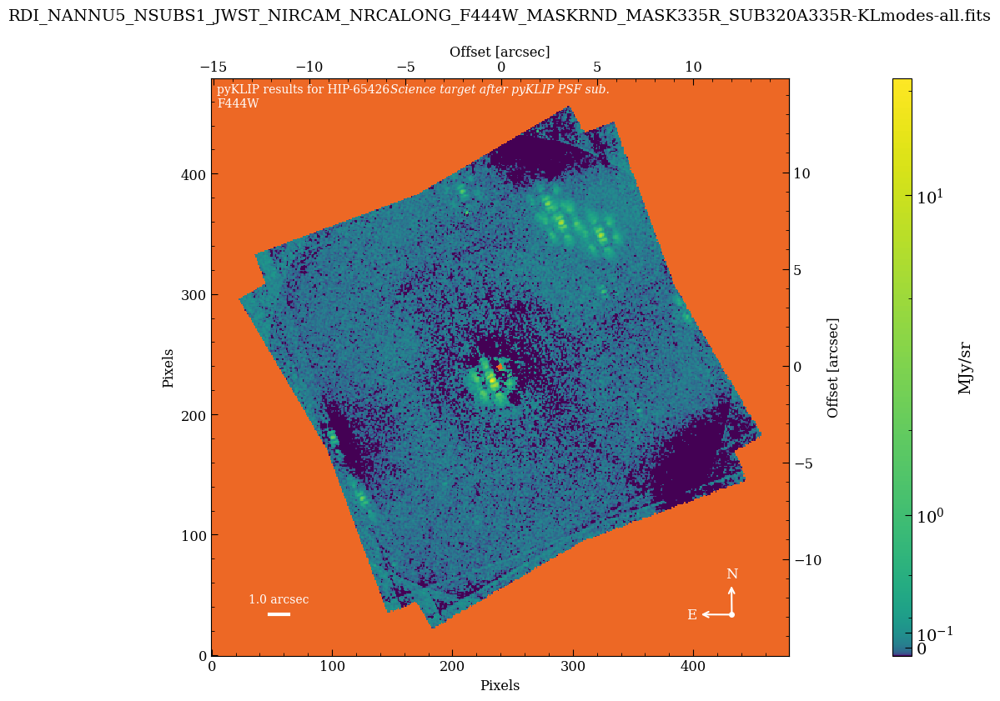

In [42]:
spaceKLIP.plotting.display_coron_dataset(database, 
                                         restrict_to=filt, save_filename='plots_f444w_pyklip.pdf')

Hurray! We’ve reached the end of the reduction process for NIRCam coronagraphic data. Now, we can move on to Part 2 of this tutorial to analyze the results. **** Add some comment about the planet now being visible, as well as the other sources in the image. 

